<div style="width:100%; height:140px">
    <img src="https://www.kuleuven.be/internationaal/thinktank/fotos-en-logos/ku-leuven-logo.png/image_preview" width = 300px, heigh = auto align=left>
</div>


KUL H02A5a Computer Vision: Group Assignment 1
---------------------------------------------------------------
Student numbers: <span>r0829517, r0816917, r0823033, r0833114, r0828881</span>.
---------------------------------------------------------------

---------------------------------------------------------------
This notebook is structured as follows:
  
0. Data loading & Preprocessing  
1. Feature Representations  
2. Performance metrics  
3. Classifiers  
4. Experiments  
5. Publishing best results  
6. Discussion  
  
---------------------------------------------------------------

In [1]:
# Install required libraries
def install_prerequisites():
    """Install libraries"""
    !pip install dlib                      
    !pip install face_recognition
    !pip install keras-facenet

install_prerequisites()
# More to be added above, call function once at the start

     |████████████████████████████████| 100.1 MB 25 kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=c91f24d1d9ecf6c239b3f272cd192692471680920d3163d7e4caf780c60e1bba
  Stored in directory: /root/.cache/pip/wheels/d6/81/3c/884bcd5e1c120ff548d57c2ecc9ebf3281c9a6f7c0e7e7947a
Successfully built face-recognition-models
     |████████████████████████████████| 2.3 MB 817 kB/s 
  Created wheel for keras-facenet: filename=keras_facenet-0.3.2-py3-none-any.whl size=10385 sha256=ff7335fd2f0085c54b8a9bd573f2ff0a2a05238484a86748492c600e6fec3dd6
  Stored in directory: /root/.cache/pip/wheels/2b/76/1a/a29ceb07bfca098e2b0bc8690d550753a0384cbed26d5f47ee
Successfully built keras-facenet


In [2]:
# Import some useful libraries
import io                                   # Input/Output Module
import os                                   # OS interfaces
import time
import cv2                                  # OpenCV package
import numpy as np                          # linear algebra
import pandas as pd                         # data processing, CSV file I/O (e.g. pd.read_csv)
from pprint import pprint
from urllib import request                  # module for opening HTTP requests
from matplotlib import pyplot as plt        # Plotting library

import PIL.Image                            # basic image processing capabilities
import PIL.ImageDraw                        # draw on images easily (i.e. faces)
import face_recognition as fr               # import face recognition library

from skimage import feature                 # used for hog descriptor
from sklearn.manifold import TSNE           # used for dimensionality reduction
from skimage import exposure
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.svm import LinearSVC, NuSVC, SVC
from sklearn.model_selection import cross_validate, ShuffleSplit, GridSearchCV, LeaveOneOut        # gridsearch selection

from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score                # performance metrics
from tqdm.notebook import tqdm as tqdm_notebook                                                    # progress bar visualization

# 0. Data loading & Preprocessing

## 0.1. Loading data
The training set is many times smaller than the test set and this might strike you as odd, however, this is close to a real world scenario where your system might be put through daily use! In this session we will try to do the best we can with the data that we've got!  

*Note: this dataset is a subset of the* [*VGG face dataset*](https://www.robots.ox.ac.uk/~vgg/data/vgg_face/).


In [3]:
def save_dataset(train_X, train_y, train_feats, test_X,test_feats, label='FACEREC', label_feats='FL'):
    """Saves processed data and features
    label[str]:        'HAAR' or 'FACEREC'
    label_feats[str]:  'HOG' or 'SIFT' or 'FL' or 'FaceNet'
    """
    prep_path = '/kaggle/working/prepped_data/'
    if not os.path.exists(prep_path):
        os.mkdir(prep_path)

    np.save(os.path.join(prep_path, 'train_X_'+label+'.npy'), train_X)
    np.save(os.path.join(prep_path, 'train_y_'+label+'.npy'), train_y)
    np.save(os.path.join(prep_path, 'train_'+label+'_'+label_feats+'.npy'), train_feats)
    
    np.save(os.path.join(prep_path, 'test_X_'+label+'.npy'), test_X)
    np.save(os.path.join(prep_path, 'test_'+label+'_'+label_feats+'.npy'), test_feats)


def load_dataset(label='FACEREC', label_feats='FL'):
    """Loads saved data and features
    label[str]:        'HAAR' or 'FACEREC'
    label_feats[str]:  'HOG' or 'SIFT' or 'FL' or 'FaceNet'
    """
    prep_path = '/kaggle/working/prepped_data/'
    #prep_path='./'

    train_X = np.load(os.path.join(prep_path, 'train_X_'+label+'.npy'))
    train_y = np.load(os.path.join(prep_path, 'train_y_'+label+'.npy'))
    train_feats = np.load(os.path.join(prep_path, 'train_'+label+'_'+label_feats+'.npy'))
    
    test_X = np.load(os.path.join(prep_path, 'test_X_'+label+'.npy'))
    test_feats = np.load(os.path.join(prep_path, 'test_'+label+'_'+label_feats+'.npy'))
    return train_X, train_y, train_feats, test_X, test_feats

In [4]:
# Input data files are available in the read-only "../input/" directory

# When running locally uncomment following
# data_dir = 'data'
# When running on kaggle uncomment following
data_dir = "../input/kul-h02a5a-computervision-groupassignment0"
read_processed = False

if not read_processed:
    train = pd.read_csv(data_dir+'/train_set.csv', index_col = 0)
    train.index = train.index.rename('id')

    test = pd.read_csv(data_dir+'/test_set.csv', index_col = 0)
    test.index = test.index.rename('id')
    # read the images as numpy arrays and store in "img" column
    train['img'] = [cv2.cvtColor(np.load((data_dir + '/train/train/train_{}.npy').format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) 
                    for index, row in train.iterrows()]

    test['img'] = [cv2.cvtColor(np.load(data_dir+ '/test/test/test_{}.npy'.format(index), allow_pickle=False), cv2.COLOR_BGR2RGB) 
                    for index, row in test.iterrows()]

    train_size, test_size = len(train), len(test)
    "The training set contains {} examples, the test set contains {} examples.".format(train_size, test_size)
else:
    train_X, train_y, train_feats, test_X, test_feats = load_dataset('FACEREC', 'FL')

## 0.2. Let us look at the dataset
Let's have a look at the data columns and class distribution.

In [5]:
# The training set contains an identifier, name, image information and class label
train.head(1)
# The test set only contains an identifier and corresponding image information.
test.head(1)
# The class distribution in the training set:
train.groupby('name').agg({'img':'count', 'class': 'max'})

,img,class
name,,
Jesse_Eisenberg,30,1
Michael_Cera,10,0
Mila_Kunis,30,2
Sarah_Hyland,10,0


### For Image Visualization
Modified function used to visualize sequence of images. It plots empty figures to fill the last row


In [6]:
from math import ceil
def plot_image_sequence(data, n, imgs_per_row=10):
    """Used to plot image sequences, a little botched when using them"""
    n_rows = ceil(n/imgs_per_row)
    n_cols = min(imgs_per_row, n)

    f,ax = plt.subplots(n_rows,n_cols, figsize=(10*n_cols,10*n_rows))
    for i in range(n):
        if n_rows > 1:
            ax[int(i/imgs_per_row),int(i%imgs_per_row)].imshow(data[i])
        else:
            ax[int(i%n)].imshow(data[i])
    plt.show()

### For Displaying raw input images
Function used to plot a sequence of resized input image dataset

In [7]:
def get_raw(data,img_size=(500,500)):
    """Function used to return an array of raw images"""
    return np.stack([cv2.resize(row['img'], img_size, interpolation = cv2.INTER_AREA) for _, row in data.iterrows()]).astype(int)

train_raw = get_raw(train)
train_raw_y = train['class'].values
#print(train_raw.shape)

### Might as well check the functions above
i.e. Plot all raw images that belong to the 1st class.  


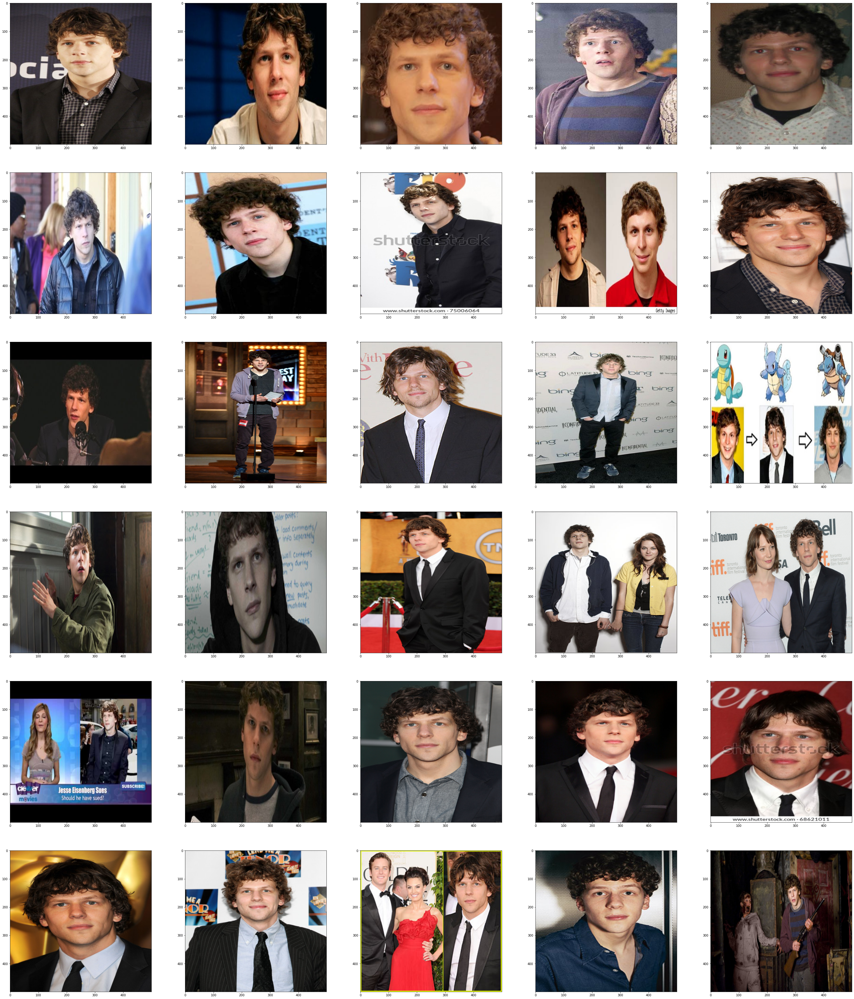

In [8]:
# Visualize raw images
plot_image_sequence(train_raw[train_raw_y == 1], n=30, imgs_per_row=5)      # plot class 1

*Note* that **Jesse is assigned label 1**, and **Mila is assigned label 2**. The dataset also contains 20 images of **look alikes (assigned classification label 0)** and the raw images. We can also plot the other classes by changing the label value to 0 and 2
 

### Observations
Since the training dataset comprises only 80 images, we first plot all of them. We immediately make 2 major observations:  
1) There are some images with multiple faces,  
2) There are 2 instances on the training set with people that belong to class 1 and class 0

The ideal preprocessor for the data should be able to detect all faces within the image and then extract features for each of the detected faces. Also, in order to make sure we achieve optimal results, the training dataset should be cleaned in order to remove redundant/unwanted faces before training.


## 0.3. Preprocess data
On this step, we focus on implementing certain face detectors in order to optimally detect faces in our image sets. The classes return images with all cropped detected faces.
### 0.3.1. HAAR face detector
First, we try the [HAAR feature based cascade classifiers](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_objdetect/py_face_detection/py_face_detection.html) developed by [Viola and Jones](https://www.merl.com/publications/docs/TR2004-043.pdf) in 2004. HAAR is a simple, yet powerful algorithm which makes locating faces on images a trivial task. Of course if we provide HAAR a great amount of data we can eventually train it to recognize all sort of objects. All faces are then resized to a fixed size (i.e. 100x100 px) so that they all have the same shape. The class has been modified to keep all detected face.


In [9]:
class HAARPreprocessor():
    """Preprocessing pipeline built around HAAR feature based cascade classifiers. Returns cropped faces"""
    def __init__(self, path='tmp', face_size=(100,100)):
        self.face_size = face_size              # size of faces to detect
        self.no_of_faces = -1                   # number of faces detected in a single image. Init to negative value
        file_path = os.path.join(path, "haarcascade_frontalface_default.xml")
        if not os.path.exists(file_path):       # if directory does not exist, then create it
            if not os.path.exists(path):
                os.mkdir(path)
            
            self.download_model(file_path)      # download haar cascade model
        
        self.classifier = cv2.CascadeClassifier(file_path)          # set classifier object
  
    def download_model(self, path):
        """Download the HAAR detector"""
        url = "https://raw.githubusercontent.com/opencv/opencv/master/data/"\
            "haarcascades/haarcascade_frontalface_default.xml"
        
        with request.urlopen(url) as r, open(path, 'wb') as f:      # download haar descriptor and write it to .xml file
            f.write(r.read())
            
    def detect_faces(self, img):
        """Detect all faces in an image"""
        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)            # color to grayscale
        faces = self.classifier.detectMultiScale(                   # find all faces on img
            img_gray,
            scaleFactor=1.2,
            minNeighbors=5,
            minSize=(30, 30),
            flags=cv2.CASCADE_SCALE_IMAGE
        )
        self.no_of_faces = len(faces)                               # keep track of detected faces
        if self.no_of_faces > 1:                                    # if more than one faces were found, then increase the outlier counter
            #print(f'Found {self.no_of_faces} faces on img. Keeping all')
            pass
        return faces                                                # return locations of all faces found
        
    def extract_face(self, img):
        """Returns faces (cropped) in an image."""
        faces = self.detect_faces(img)                              # get locations of detected faces
        f = [img[y:y+h, x:x+w] for (x, y, w, h) in faces]           # crop the images accordingly and save them to a list
        return f                                                    # return the list of the cropped images
    
    def preprocess(self, data_row):
        faces = self.extract_face(data_row['img'])                  # get list of cropped images     
        if self.no_of_faces == 0:                                   # if no faces were detected, return array of 0
            zero_img = np.zeros((1,) + self.face_size + (3,))       # dimensions: 1xFACE_SIZExFACE_SIZEx3 since it is color
            return zero_img
        list_of_faces = [cv2.resize(face, self.face_size, interpolation = cv2.INTER_AREA) for face in faces]    # resize all images to given height, width
        return np.stack([f for f in list_of_faces]).astype(int)     # return np.array NxFACE_SIZExFACE_SIZEx3, where N is the detected faces
            
    def __call__(self, data, labels):
        faces_arr = np.zeros((0,) + self.face_size + (3,), dtype=int)   # init array to store all faces
        L = np.zeros((0,), dtype=int)                                   # init array that holds the target label
        I = np.zeros((0,), dtype=int)                                   # init array the holds the corresponding image id
        if labels is not None:                                          # case: training set
            for (_, row), ider, l in tqdm_notebook(zip(data.iterrows(),data.index,labels), total=len(labels)):# iterate over images and labels
                tmp = self.preprocess(row)                              # get nd.array of all cropped faces detected
                faces_arr = np.append(faces_arr, tmp, axis=0)           # store them to an array
                L = np.append(L, [l] * max(1,len(tmp)))
                I = np.append(I, [ider] * max(1,len(tmp)))
        else:                                                           # if labels = None then just do the images
            for (_, row), ider in tqdm_notebook(zip(data.iterrows(),data.index), total=data.shape[0]):# iterate over images and identifiers
                tmp = self.preprocess(row)
                faces_arr = np.append(faces_arr, tmp, axis=0)
                I = np.append(I, [ider] * max(1,len(tmp)))

        return faces_arr.astype(int), L, I                              # return np.array NxFACE_SIZExFACE_SIZEx3, np.array Nx1 with labels

### 0.3.2 Face recognition detector
Here we use the [Face_recognition](https://pypi.org/project/face-recognition/) package from pypi in order to detect faces. This package can be used to recognize and manipulate faces from Python (or even from the command line) and is built using dlib. It can detect faces based on HOG(model='hog') and deep learning (model='cnn'). The second one should generally be used with GPU acceleration for efficiency. From our experiments, we concluded that the HOG method is adequate since it finds all faces in most cases.  
The package also offers more capabilities i.e. encodings of faces, face identification and comparison based on similarity, facial landmarks detection. We use the face encodings generated by raw facial landmarks as features in section 1.

NOTE: The [creator](https://github.com/ageitgey/face_recognition) states that it generally fails with faces of children

In [10]:
class Face_recPreprocessor():
    """Preprocessing pipeline using the 'face-recognition' library based on dlib. """
    def __init__(self, face_size=(100, 100)):
        self.encodings = []                                             # list to keep all raw facial landmarks.
        self.face_size = face_size                                      # size of faces to detect.
        self.no_of_faces = 0                                            # number of faces detected in a single image.and
        self.model = 'hog'                                              # can be either 'hog' or 'cnn'.

    def detect_faces(self, img):
        """Detects all faces in an image"""
        if self.model == 'cnn':                                         # case: CNN
            face_loc = fr.face_locations(img, model=self.model)
        else:                                                           # case: if 'hog' or illegal term, then use 'hog' by default
            face_loc = fr.face_locations(img)
        
        # calculate the raw facial landmarks for each detected face
        l = fr.face_encodings(img, known_face_locations=face_loc, num_jitters=10)
        self.no_of_faces = len(face_loc)                                # keep number of detected faces
        if self.no_of_faces > 1:
            #print(f'Found {self.no_of_faces} faces on img. Keeping all')
            pass
        if self.no_of_faces == 0:
            #print(f'encodings:{np.shape(l)}')
            l = np.zeros((1,128))
        self.encodings.extend(l)                                        # store the encodings
        return face_loc
        
    def extract_faces(self, img):
        """Returns faces (cropped) in an image"""
        faces = self.detect_faces(img)                                  # get locations of detected faces

        # crop the images accordingly and save them to a list
        f = [img[top:bottom, left:right] for (top, right, bottom, left) in faces]
        return f                                                        # return the list of the cropped images
    
    def preprocess(self, data_row):
        faces = self.extract_faces(data_row['img'])                     # get list of cropped images     
        if self.no_of_faces == 0:                                       # if no faces were detected, return array of 0
            zero_img = np.zeros((1,) + self.face_size + (3,))           # dimensions: 1xFACE_SIZExFACE_SIZEx3 since it is color
            return zero_img
        # resize all images to given height, width
        list_of_faces = [cv2.resize(face, self.face_size, interpolation = cv2.INTER_AREA) for face in faces]
        return np.stack([f for f in list_of_faces]).astype(int)         # return np.array NxFACE_SIZExFACE_SIZEx3, N is the detected faces
      
    def __call__(self, data, labels, model='hog'):
        self.model = model                                              # set recognition type default to 'hog'
        self.encodings = []                                             # init face_encodings to empty list
        faces_arr = np.zeros((0,) + self.face_size + (3,), dtype=int)   # init array to store all faces
        L = np.zeros((0,), dtype=int)                                   # init array that holds the target label
        I = np.zeros((0,), dtype=int)                                   # init array the holds the corresponding image id
        if labels is not None:
            for (_, row), ider, l in tqdm_notebook(zip(data.iterrows(),data.index,labels), total=data.shape[0]):# iterate over images, identifiers and labels
                tmp = self.preprocess(row)                              # get nd.array of all cropped faces detected
                faces_arr = np.append(faces_arr, tmp, axis=0)           # append to array
                L = np.append(L, [l] * max(1,len(tmp)))
                I = np.append(I, [ider] * max(1,len(tmp)))

        else:                                                           # if labels = None then just do the images
            for (_, row), ider in tqdm_notebook(zip(data.iterrows(),data.index), total=data.shape[0]):
                tmp = self.preprocess(row)
                faces_arr = np.append(faces_arr, tmp, axis=0)
                I = np.append(I, [ider] * max(1,len(tmp)))
        
        # returns np.array NxNxFACE_SIZExFACE_SIZEx3, np.array Nx1 with labels, identifiers
        return faces_arr.astype(int), L, I

## Discussion 
In its initial implementation, the HAAR face detector naively returned only the first detected face. This leads to poor recognition results, since it operates under the false assumption that the 1 face that is returned at each image is of interest to us. This potentially leads to having false labels during the training phase, and completely ignoring the rest of the faces that might belong to the 2 classes (Jesse or Mila). 

Instead, we implemented 2 face detectors that return **ALL detected faces**, constructing an array of shape *Nx100x100x3*, where N is the total number of detected faces in the whole dataset, and the rest are the cropped images. They also return their **corresponding truth label L** (for training dataset), and the **corresponding identifier I** of the image that the face comes from. The latter is needed in order to reconstruct our final predicted labels, keeping only one identified face per image.

### 0.3.3. Preprocessing utility functions
Certain utility functions used later on for processing purposes

In [11]:
def data2grayscale(X):
    """Converts dataset of images to grayscale"""
    gray_images = np.zeros((X.shape[0],X.shape[1],X.shape[2]))
    for ii in range(X.shape[0]):
        gray_images[ii,:,:] = cv2.cvtColor(X[ii].astype('uint8'),
                                           cv2.COLOR_BGR2GRAY)
    return gray_images

def flatten(X):
    """Flattens dataset of images"""
    return np.reshape(X, (len(X), -1))

def rmv_blacks(data,labels):
    """Removes all completely zero arrays from the dataset"""
    idx_list = []
    for i in range(data.shape[0]):
        if not np.count_nonzero(data[i,:]):                 # if completely zero
            idx_list = np.append(idx_list,i).astype(int)    # store index and then return a copy with those indexes deleted
    return np.delete(data, idx_list, 0),np.delete(labels, idx_list, 0), len(idx_list) 

### 0.3.4. Preprocess training and testing data HAAR

In [12]:
# Choose preprocessor and run this for the training dataset
preprocessor = HAARPreprocessor()                                           # create HAAR preprocessor object

train_X_old_HAAR, train_y_old_HAAR, ider_HAAR = preprocessor(train, train['class'].values)
test_X_HAAR, _, ider_test_HAAR = preprocessor(test, None)

train_samples_HAAR = train_X_old_HAAR.shape[0]                                        # store number of train image samples
test_samples_HAAR = test_X_HAAR.shape[0]                                              # store number of test image samples

train_cls0 = train_X_old_HAAR[train_y_old_HAAR==0].shape[0]                           # store number of train samples with class 0
train_cls1 = train_X_old_HAAR[train_y_old_HAAR==1].shape[0]                           # store number of train samples with class 1
train_cls2 = train_X_old_HAAR[train_y_old_HAAR==2].shape[0]                           # store number of train samples with class 2
print(f'Train samples: {train_samples_HAAR}, class 1 samples: {train_cls1}, class 2 samples: {train_cls2}')
print(f'Test samples: {test_samples_HAAR}')
print(np.shape(train_X_old_HAAR), np.shape(train_y_old_HAAR), np.shape(ider_HAAR))

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/1816 [00:00<?, ?it/s]

Train samples: 104, class 1 samples: 41, class 2 samples: 39
Test samples: 2371
(104, 100, 100, 3) (104,) (104,)


Let's plot all detected images using HAAR

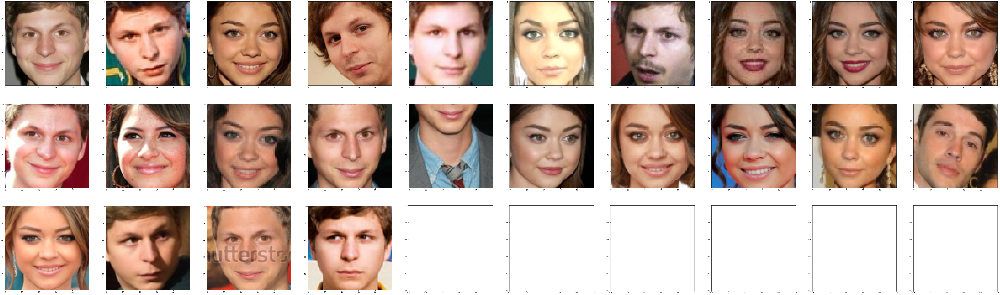

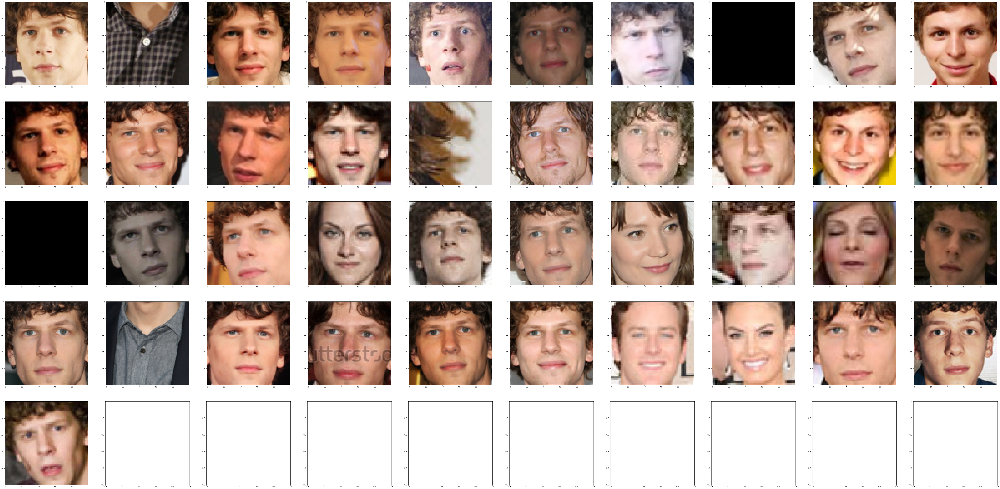

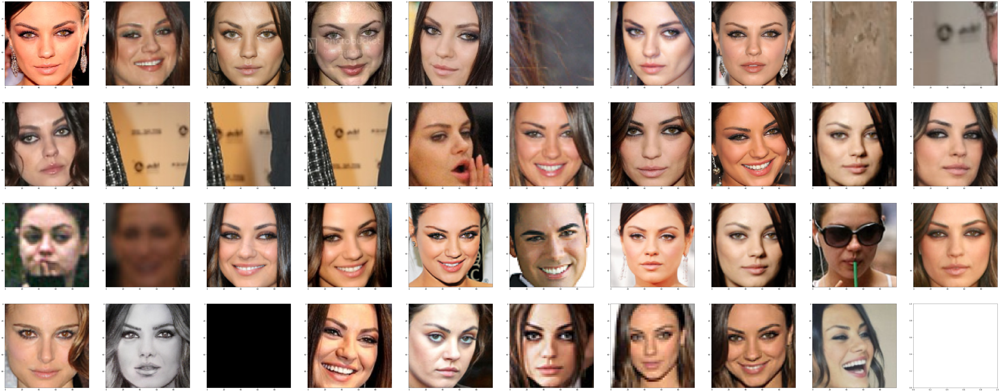

In [13]:
plot_image_sequence(train_X_old_HAAR[train_y_old_HAAR == 0], n=train_cls0, imgs_per_row=10)       # plot faces of Michael and Sarah
plot_image_sequence(train_X_old_HAAR[train_y_old_HAAR == 1], n=train_cls1, imgs_per_row=10)       # plot faces of Jesse
plot_image_sequence(train_X_old_HAAR[train_y_old_HAAR == 2], n=train_cls2, imgs_per_row=10)       # plot faces of Mila

### 0.3.5. Preprocess training and testing data FACEREC

In [14]:
# Choose preprocessor and run this for the training dataset
preprocessor = Face_recPreprocessor()                                                 # create face_recognition object

train_X_old_FACEREC, train_y_old_FACEREC, ider_FACEREC = preprocessor(train, train['class'].values)
train_encodings_old_FACEREC = preprocessor.encodings.copy()                           # get encodings, use them as features to clean dataset

test_X_FACEREC, _, ider_test_FACEREC = preprocessor(test, None)
test_feats_FACEREC = preprocessor.encodings.copy()

train_samples_FACEREC = train_X_old_FACEREC.shape[0]                                     # store number of train image samples
test_samples_FACEREC = test_X_FACEREC.shape[0]                                           # store number of test image samples

train_cls0 = train_X_old_FACEREC[train_y_old_FACEREC==0].shape[0]                        # store number of train samples with class 0
train_cls1 = train_X_old_FACEREC[train_y_old_FACEREC==1].shape[0]                        # store number of train samples with class 1
train_cls2 = train_X_old_FACEREC[train_y_old_FACEREC==2].shape[0]                        # store number of train samples with class 2
print(f'Train samples: {train_samples_FACEREC}, class 1 samples: {train_cls1}, class 2 samples: {train_cls2}')
print(np.shape(train_X_old_FACEREC), np.shape(train_y_old_FACEREC), np.shape(ider_FACEREC))

print(f'Test samples: {test_samples_FACEREC}')

  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/1816 [00:00<?, ?it/s]

Train samples: 97, class 1 samples: 38, class 2 samples: 36
(97, 100, 100, 3) (97,) (97,)
Test samples: 2337


*NOTE: The first dimension on all 3 train arrays above should be the same number*  
  
### Plot the image samples for the train dataset  
Now let us check the cropped faces from the images


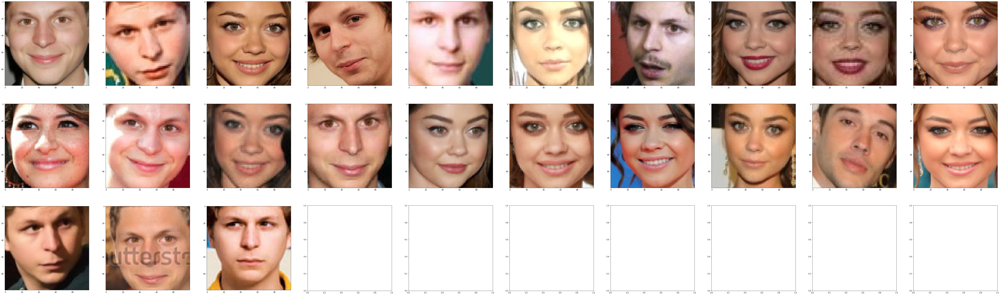

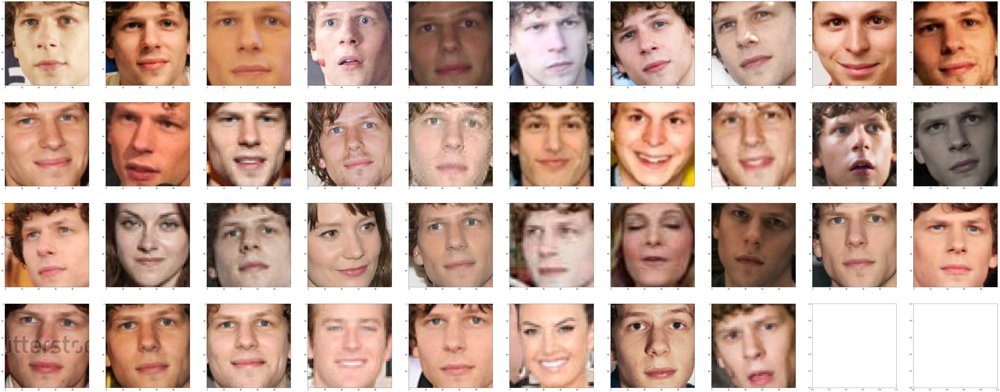

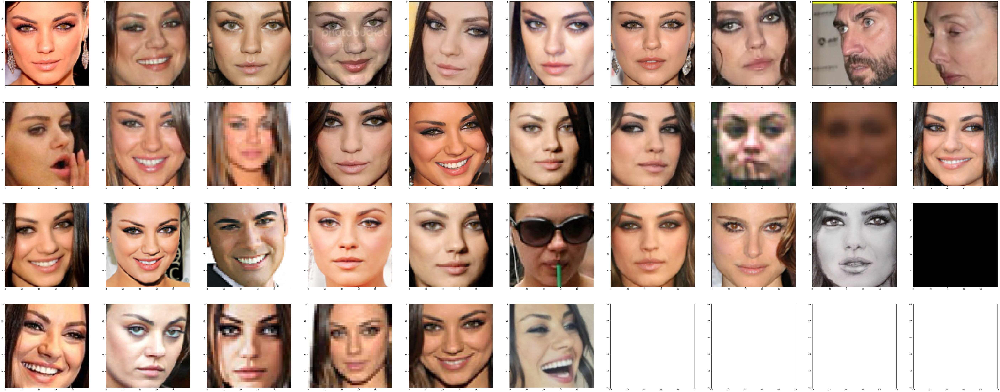

In [15]:
plot_image_sequence(train_X_old_FACEREC[train_y_old_FACEREC == 0], n=train_cls0, imgs_per_row=10)       # plot faces of Michael and Sarah
plot_image_sequence(train_X_old_FACEREC[train_y_old_FACEREC == 1], n=train_cls1, imgs_per_row=10)       # plot faces of Jesse
plot_image_sequence(train_X_old_FACEREC[train_y_old_FACEREC == 2], n=train_cls2, imgs_per_row=10)       # plot faces of Mila

# 1. Feature Representations
## 1.1.0. Identity feature extractor
An example feature extractor that doesn't actually do anything. It just returns the input:
$$
\forall x : f(x) = x.
$$

The class below is going to be used as baseline for all of our feature extractors.

In [16]:
class IdentityFeatureExtractor:
    """A simple function that returns the input"""

    def transform(self, X):
        return X
    
    def __call__(self, X):
        return self.transform(X)

## 1.1.1. HOG feature extractor
The Histogram of Oriented Gradients (HOG) is a feature descriptor used in computer vision and image processing applications. It was developed by [Dalal and Triggs (2005)](https://ieeexplore.ieee.org/document/1467360z) and was initially aimed for human detection. HOG descriptors are mainly used to describe the structural shape and appearance of an object in an image, making them excellent descriptors for object classification. Moreover, since HOG captures local intensity gradients and edge directions, it also makes for a good texture descriptor.


The Histograms of oriented gradients is a local descriptor. Such algorithm describes the gradient orientation in small areas of an image, and then it collects the information obtained [from all regions into a single vector](https://learnopencv.com/histogram-of-oriented-gradients/). In our example the image is partitioned into regions that are named cells; each cell contains 6x6 pixels. So the methodology of the HOG descriptor is to describe firstly each cell separately, by computing vectors that represent the histograms of orientated gradients of each cell (vector contains 10 bins) before concatenating them in a single vector. To increase immunity against light variations and lighting conditions, they normalized all 2x2 cells (this set was called a block) to an L2-Hys norm. It is important to mention here, that in the previous assignment the features were based only on the thresholded color values in the RGB or HSV space. The main drawback of this thresholding technique is that it is affected by the lighting conditions or the density values of the object that we are interested in, while HoG features combined with block normalization prove more resilient. 

The patch size is a design choice informed by the scale of features we are looking for. In our case, 15×15 patch cells were selected, because in a photo of a face scaled to 100×100, these cells are big enough to capture interesting features ( e.g. the nose, the eyes, the ears etc.), wheras smaller cells (i.e. 32x32) will not be able to capture these features.


In [17]:
from skimage.feature import hog
class HOGFeatureExtractor(IdentityFeatureExtractor):
    """Calculate HOG features for all images in dataframe"""
    def __init__(self, orientations=9, pixels_per_cell=(15,15), cells_per_block=(4,4), visualize=True, multichannel=True,
                 block_norm='L2-Hys', feature_vector=True):

        self.ider = None                                                # holds identifier of image where the corresponding face was found
        self.options = {'orientations':orientations,                    # HOG parameters
                        'pixels_per_cell':pixels_per_cell,
                        'cells_per_block':cells_per_block,
                        'visualize':visualize,
                        'multichannel':multichannel,
                        'block_norm':block_norm,
                        'feature_vector':feature_vector
                        }

    def process(self, img):
        fd, _ = hog(img, **self.options)       # return descriptor only
        return fd

    def transform(self, test_X):
        #test_X,_,self.ider = self.preprocessor(test, None)              # use preprocessor to detect faces and return test_X, img identifiers
        descriptors = [self.process(test_X[i,:]) for i in range(test_X.shape[0])]
        return np.array(descriptors)

## 1.1.2. PCA feature extractor
Using each pixel of an image as a feature means that one 100x100 px size image results to 10.000 dimensions which is a lot for most standard classifiers (i.e. SVM). [Principal component analysis (PCA)](https://en.wikipedia.org/wiki/Principal_component_analysis), developed in 1901 by mathematician [Karl Pearson](https://en.wikipedia.org/wiki/Karl_Pearson), is a fast and flexible unsupervised method for dimensionality reduction in data.

We use PCA to reduce the dimensions of the data to a more manageable size, while maintaining most of the information in the dataset. Intuitively, it can be thought of as fitting a high dimensional ellipsoid to the data. Each axis of the ellipsoid represents a principal component or eigenvector of the covariance matrix of the data. A small axis denotes small variance in that dimension and hence it does not contain much information about the dataset. PCA works under the assumption that the eigenvectors are orthogonal which is means they have little correlation among them or are completely uncorrelated. PCA is also performed on a symmetric correlation or covariance matrix, which means data should be transformed to numeric values, standardized and normalized to a [0,1] range.  
In general, all dimensionality reduction techniques, aim to find some hyperplane, a higher-dimensional line, to project the points onto. The idea behind PCA is that we want to select the hyperplane such that when all the points are projected onto it, they are maximally spread out. In other words, we want the axes of maximal variance.

Sources: [1](https://www.stat.cmu.edu/~cshalizi/uADA/12/lectures/ch18.pdf), [2](https://towardsdatascience.com/dimensionality-reduction-does-pca-really-improve-classification-outcome-6e9ba21f0a32)

In [18]:
class PCAFeatureExtractor(IdentityFeatureExtractor):
    """Calculate PCA features for all images in dataframe"""
    def __init__(self, n_components):
        self.n_components = n_components
        self.pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_components))])
        
    def transform(self, X):
        X = convert_imgs_for_PCA(X)
        self.face_proj = self.pipeline.fit_transform(X)
        return self.face_proj
    
    def inverse_transform(self, X):
        self.inv_face_proj = self.pipeline.named_steps['pca'].inverse_transform(X)
        return self.inv_face_proj


def convert_imgs_for_PCA(data):
    gray_images = np.zeros((data.shape[0],data.shape[1],data.shape[2]))
    for x in range(data.shape[0]):
        gray_images[x,:,:] = cv2.cvtColor(data[x].astype('uint8'), cv2.COLOR_BGR2GRAY)
    m = gray_images.shape[0]
    d = gray_images.shape[1] * gray_images.shape[2]
    return np.reshape(gray_images, (m, d))

## 1.1.3. SIFT Feature Extractor
[Scale Invariant Feature Transform (SIFT)](https://en.wikipedia.org/wiki/Scale-invariant_feature_transform), developed by [David Lowe (1999)](https://link.springer.com/article/10.1023/B:VISI.0000029664.99615.94), is a feature detection algorithm for computer vision applications. SIFT finds local features in the image, commonly known as ‘keypoints‘, based on the Difference of Gaussians (DoG) and utilizing the sigma as [a scaling parameter](https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_sift_intro/py_sift_intro.html). These keypoints are scale & rotation invariant and are used for various computer vision tasks, like image matching, object detection, scene detection, etc. The descriptors of the generated keypoints can be used for this face recognition task during model training after flattening them to a fixed shape or using some dimensionality reduction (i.e. PCA) beforehand. 

In [19]:
class SIFTFeatureExtractor(IdentityFeatureExtractor):
    """Basic SIFT extraction using openCV"""
    def __init__(self):
        self.ids = None
        self.sift = cv2.SIFT_create()

    def process(self, img):
        gray = cv2.cvtColor(np.uint8(img),cv2.COLOR_BGR2GRAY)
        kp, des = self.sift.detectAndCompute(gray, None)
        return des

    def transform(self, test_X):
        #test_X,_,self.ider = self.preprocessor(test, None)
        descriptors = [self.process(test_X[i,:]) for i in range(test_X.shape[0])]
        return np.array(descriptors)

## 1.1.4. Raw facial landmarks feature extractor
Facial landmarks (characteristic face regions i.e. mouth, eyebrows, nose, eyes) can be used in face recognition tasks as features. They have been successfully applied to tasks like face alignment, head pose estimation, and face swapping. They are robust and more specific to the task since they capture information about the face structure, distances among facial features etc. We use the built-in facial landmark detector inside the [dlib library](http://dlib.net/face_landmark_detection.py.html) that comes with the face_recognition package in order to compute a 128-dimensional feature vector for each detected face. Computing these encodings for the test dataset takes a lot of time since it is an expensive task.

In [20]:
class FaceLandmarksExtractor(IdentityFeatureExtractor):
    """Use facial landmarks as computed by face_recognition"""
    def __init__(self):
        self.ider = None

    def transform(self, test):
        preprocessor = Face_recPreprocessor()
        _,_,self.ider = preprocessor(test, None)
        descriptors = preprocessor.encodings.copy()
        return descriptors

## 1.1.5. FaceNet
[FaceNet](https://arxiv.org/abs/1503.03832) is a face recognition network developed in 2015 by Google. In this section, we use a FaceNet from [this online package](https://pypi.org/project/keras-facenet/) by Fausto Morales, which is a Keras wrapper of [this implementation](https://github.com/davidsandberg/facenet) of David Sandberg. FaceNet is a deep learning model that extracts high-quality facial embeddings that can be used with any standard machine learning model (i.e. SVM). According to the authors, "*this method uses a deep convolutional network trained to directly optimize the embedding itself, rather than an intermediate bottleneck layer*".  

The model used here is the '20180402-114759' which generates a 512 feature vector for each detected face. We expect the generated image features to be of higher quality than the standard SIFT, HOG and PCA methods.

In [21]:
from keras_facenet import FaceNet
class FaceNetExtractor(IdentityFeatureExtractor):
    """Use FaceNet to extract high quality features"""
    def __init__(self):
        self.ider = None
        self.embedder = FaceNet()

    def process(self, img):
        return self.embedder.embeddings(img)
        
    def transform(self, test_X):
        test_X_list = [test_X[i,:].astype(np.uint8) for i in range(test_X.shape[0])]     # needs a list of cropped images
        return self.embedder.embeddings(test_X_list)

## 1.1.6. ResNet50 as a feature extractor
The following feature extractor uses a residual deep learning network (ResNet50). We download the ResNet50 pre-trained on 'imageNet' and we change the input size with an added Input layer. Then we remove the final fully connected layer in order to use the new model as a feature extractor of 2048 dimensions. 

In [22]:
from keras.applications.resnet50 import ResNet50
from keras.preprocessing import image
from keras.models import Model
from keras.layers import Flatten, Input
from keras.applications.resnet50 import preprocess_input, decode_predictions

class ResnetExtractor(IdentityFeatureExtractor):
    """Use ResNet50 DL model to extract features"""
    def __init__(self):
        base_model = ResNet50(weights='imagenet', input_tensor=Input(shape=(100, 100, 3)), include_top = True)
        self.model = Model(inputs=base_model.input, outputs=base_model.layers[-2].output)
    
    def preprocess(self,x):
        #x = cv2.resize(x, (224,224), interpolation = cv2.INTER_CUBIC)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)
        return self.model.predict(x).squeeze()

    def transform(self, test_X):
        x = [self.preprocess(test_X[i,:].astype(np.uint8)) for i in range(test_X.shape[0])]
        features = np.array(x)
        return features

## Test Feature Extractors
In this section we extract some features using the above mentioned methods. These features can be used for cleaning the dataset (see *section 1.2*) or for simple visualization purposes.

In [23]:
"""Extract HOG features of the train dataset from scratch"""
hog_extractor = HOGFeatureExtractor(pixels_per_cell=(15,15),cells_per_block=(5,5),orientations=8,block_norm="L2-Hys")
ftrs_hog = hog_extractor(train_X_old_HAAR)
print(ftrs_hog.shape)

(104, 800)


In [24]:
"""Extract SIFT features of the train dataset from scratch"""
sift_extractor = SIFTFeatureExtractor()
ftrs_sift = sift_extractor(train_X_old_HAAR)
print(ftrs_sift.shape)

(104,)


/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  from ipykernel import kernelapp as app


In [25]:
"""Extract FaceNet features of the clean train dataset"""
embedder = FaceNet()
train_X_list = [train_X_old_HAAR[i,:].astype(np.uint8) for i in range(train_X_old_HAAR.shape[0])]     # needs a list of cropped images
ftrs_facenet = embedder.embeddings(train_X_list)
print(ftrs_facenet.shape)

(104, 512)


In [26]:
"""Extract ResNet50 features of the clean train dataset"""
resnet = ResnetExtractor()
ftrs_resnet = resnet(train_X_old_FACEREC)
print(ftrs_resnet.shape)

102973440/102967424 [==============================] - 2s 0us/step
(97, 2048)


## 1.2. Clean Training Dataset 
In this section we examine which of the redundant faces are outliers and should be removed.  
1) First, we use feature vectors of images (i.e. Facial Landmarks FL) and we calculate the pair cosine similarities of the feature vectors  
2) Secondly, we remove the images that are most dissimilar within their class  
3) Third, we reconstruct our final 'train_X_METHOD', 'train_y_METHOD' etc.
  
*NOTE:* Any kind of features can be used in step 1 in order to construct the feature vectors. 

In [27]:
from sklearn.metrics import pairwise_distances
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.utils import shuffle

def calc_dist(features, k):
    """Calculates pairwise cosine distance among feature vectors"""
    cos_dis = pairwise_distances(features, metric='cosine')         # calc pairwise cosine distance
    sum_d = -1*np.sum(cos_dis,axis=0)                               # naively get sum as a metric to check which vectors are most dissimilar
    return cos_dis, np.argpartition(sum_d, k)                       # return distance matrix, idx where imgs to be deleted exist

def calc_sim(features, k):
    """Calculates pairwise cosine similarity among feature vectors(preferred with image vectors)"""
    cos_sim = cosine_similarity(features, features)                 # calc pairwise cosine similarity among features
    # print(cos_sim.shape)
    sum_s = np.sum(cos_sim,axis=0)                                  # naively get sum as a metric to check which vectors are most dissimilar
    return cos_sim, np.argpartition(sum_s, k)                       # return distance matrix, idx where imgs to be deleted exist

def get_clean_training_set(train_X, features, train_y):
    """Find the vectors that are most dissimilar with the rest within each class"""    
    # Class 1
    sim_list = []
    ft_class_1 = features[train_y==1]                                   # get features for class 1
    k = ft_class_1.shape[0]-30                                          # k: the number of img that we need to have removed
    sim, idx = calc_sim(ft_class_1,k)                                   # get distances

    train_class_1_tmp = train_X[train_y==1]                             # get new train_set for the class 
    train_class_1 = np.delete(train_class_1_tmp, idx[:k], 0)            # delete outlier imgs
    ft_class_1 = np.delete(ft_class_1,idx[:k],0)
    sim_list.append(sim)

    # Class 2
    ft_class_2 = features[train_y==2]                                   # get features for class 2
    k = ft_class_2.shape[0]-30                                          # k: the number of img that we need to have removed
    sim, idx = calc_sim(ft_class_2,k)                                   # get new train_set for the class 

    train_class_2_tmp = train_X[train_y==2]                             # get new train_set for the class 
    train_class_2 = np.delete(train_class_2_tmp, idx[:k], 0)            # delete outlier imgs
    ft_class_2 = np.delete(ft_class_2,idx[:k],0)
    sim_list.append(sim)
    
    # Class 0
    ft_class_0 = features[train_y==0]                                   # get features for class 0
    k = ft_class_0.shape[0]-20                                          # k: the number of img that we need to have removed
    sim, idx = calc_sim(ft_class_0,k)                                   # get new train_set for the class 

    train_class_0_tmp = train_X[train_y==0]                             # get new train_set for the class 
    train_class_0 = np.delete(train_class_0_tmp, idx[:k], 0)            # delete outlier imgs
    ft_class_0 = np.delete(ft_class_0,idx[:k],0)
    sim_list.append(sim)

    class_list = [1,2,0]
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15,8))
    for ax, sim, i in zip(axes.flat, sim_list, class_list):
        im = ax.imshow(sim, cmap='seismic', vmin=0, vmax=1)
        ax.title.set_text(f'Cosine similarity for imgs in class {i}')

    fig.subplots_adjust(right=0.8)
    cbar_ax = fig.add_axes([0.85, 0.25, 0.05, 0.5])
    fig.colorbar(im, cax=cbar_ax)
    plt.show()
    
    train_X = np.vstack((train_class_0, train_class_1, train_class_2))
    train_encodings = np.vstack((ft_class_0, ft_class_1, ft_class_2))
    train_y = np.hstack((np.zeros(train_class_0.shape[0]), np.ones(train_class_1.shape[0]), 2*np.ones(train_class_2.shape[0]))).astype(int)
    return train_X,train_encodings,train_y

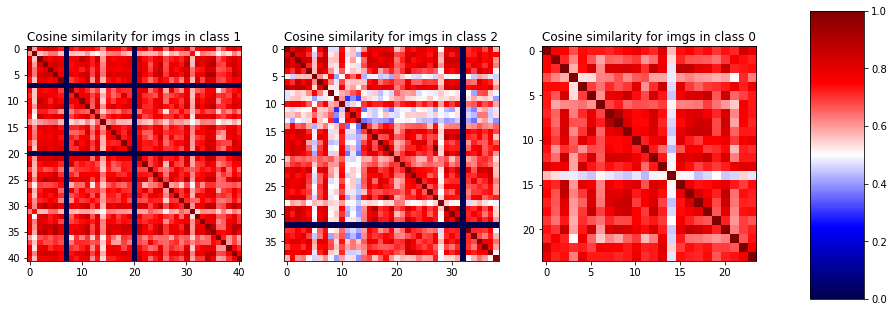

In [28]:
"""Clean the training dataset by removing outlier(most dissimilar) faces"""
train_X_HAAR, train_feats_HAAR, train_y_HAAR = get_clean_training_set(train_X_old_HAAR,np.array(ftrs_hog),train_y_old_HAAR)

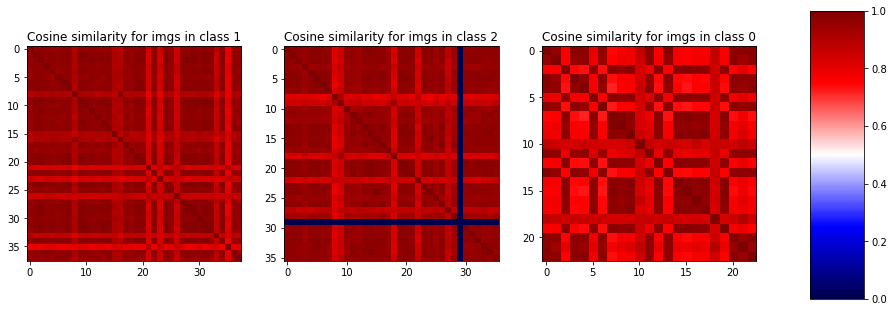

In [29]:
"""Clean the training dataset using FACEREC by removing outlier(most dissimilar) faces"""
train_X_FACEREC, train_feats_FACEREC, train_y_FACEREC = get_clean_training_set(train_X_old_FACEREC,np.array(train_encodings_old_FACEREC),train_y_old_FACEREC)

### Discussion:  
On the above plots we can see the similarity matrices for the train dataset and for each class. The goal is to spot the $N_i$ most dissimilar images in every class $i$, where we know that $N_1 = 8, N_2 = 6$ and $N_0 = 3$ when using the FACEREC preprocessor. We observe that for classes 1 and 2 this process is fairly easy, whereas for class 0 things are a bit more complicated. The reason is of course that class 0 comprises 2 different people, Sarah and Michael, and so we see a lot of dissimilarities within the class.  

We also note that all black images correspond to cases where the preprocessor failed to detect any faces, and those faces are extremely dissimilar to the rest of the dataset.  

### Let us now calculate the pairwise correlation 
We use the [pandas corr()](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.corr.html) method in order to calculate the pairwise Pearson correlation of the clean dataset and get a better idea of the similarity among the remaining images.

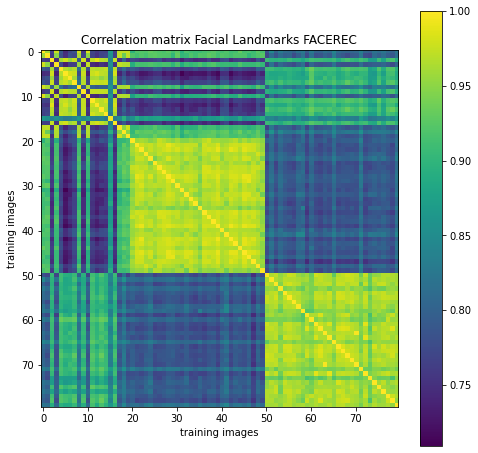

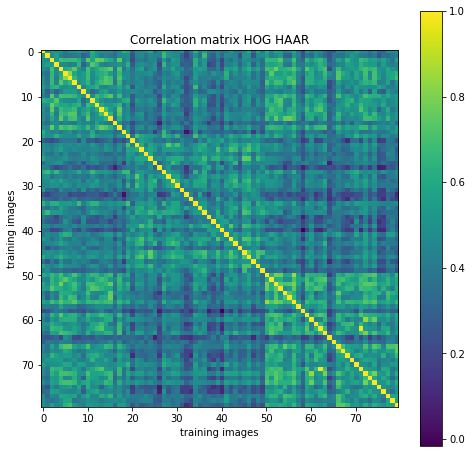

In [30]:
def plot_corr(train_feats=train_feats_FACEREC, label='Facial Landmarks FACEREC'):
    """ Correlation among all imgs with encodings features """
    data = pd.DataFrame(np.array(train_feats).T)            # convert to DataFrame
    corr = data.corr()                                      # just to use the correlation
    fig = plt.figure(figsize=(8,8))                         # make figure
    ax = fig.add_subplot(111)
    cax = ax.imshow(corr, vmin=corr.to_numpy().min(), vmax=corr.to_numpy().max())                  # show correlation matrix
    fig.colorbar(cax)
    plt.title(f'Correlation matrix {label}')
    plt.xlabel('training images')
    plt.ylabel('training images')
    
plot_corr()
plot_corr(train_feats_HAAR,'HOG HAAR')

*NOTE:* In the 1st figure above we can observe the correlation among facial landmarks features using the FACEREC preprocessor before shuffling our dataset. The first 20 images are labeled as class 0, images 21-50 are class 2 and images 51 to 80 are class 1. The difference in correlation indicates that these features are probably good enough for our face recognition purposes.  

The 2nd figure shows the correlation of HOG feature vectors using the HAAR preprocessor. We observe that Facial Landmarks appear to be better separated, and thus are considered more discriminative features.

In [31]:
from sklearn.utils import shuffle
train_X_HAAR, train_feats_HAAR, train_y_HAAR = shuffle(train_X_HAAR, train_feats_HAAR, train_y_HAAR, random_state=0)

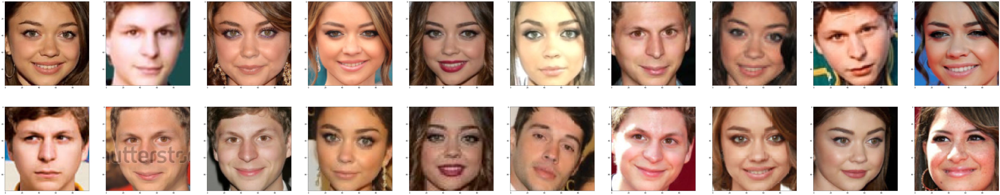

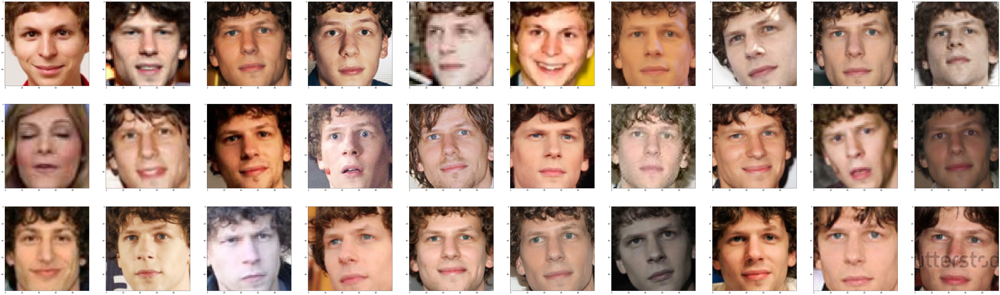

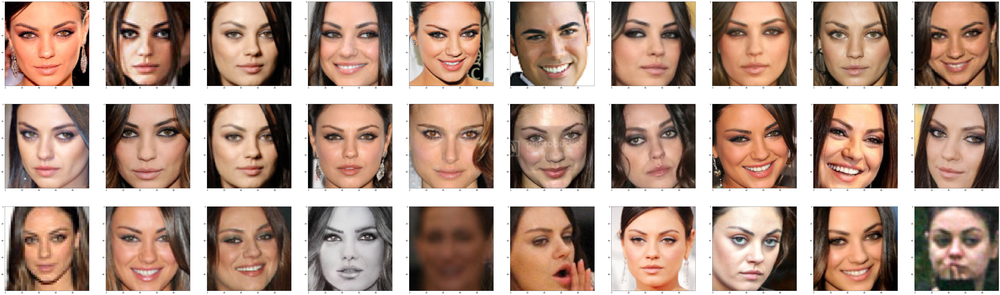

In [32]:
"""Let us now examine the clean training dataset using HOG HAAR"""
plot_image_sequence(train_X_HAAR[train_y_HAAR == 0], n=train_X_HAAR[train_y_HAAR == 0].shape[0], imgs_per_row=10)       # plot faces of Michael and Sarah
plot_image_sequence(train_X_HAAR[train_y_HAAR == 1], n=train_X_HAAR[train_y_HAAR == 1].shape[0], imgs_per_row=10)       # plot faces of Jesse
plot_image_sequence(train_X_HAAR[train_y_HAAR == 2], n=train_X_HAAR[train_y_HAAR == 2].shape[0], imgs_per_row=10)       # plot faces of Mila

In [33]:
train_X_FACEREC, train_feats_FACEREC, train_y_FACEREC = shuffle(train_X_FACEREC, train_feats_FACEREC, train_y_FACEREC, random_state=0)

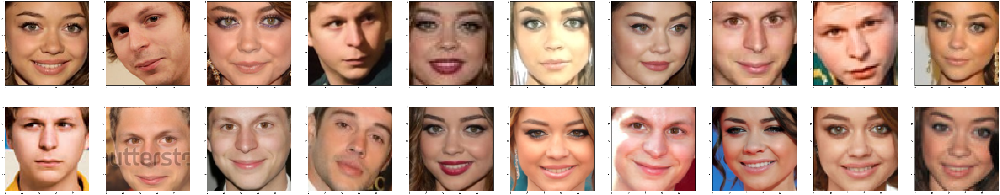

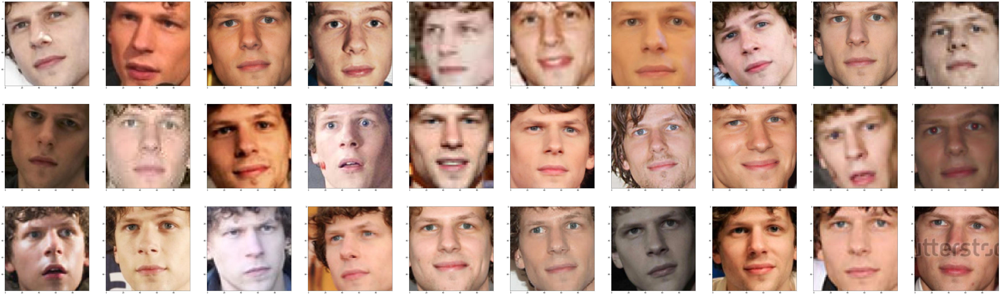

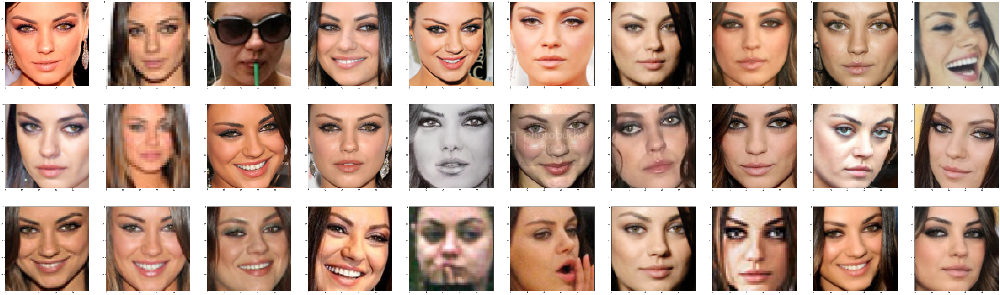

In [34]:
"""Let us now examine the clean training dataset using FL FACEREC"""
plot_image_sequence(train_X_FACEREC[train_y_FACEREC == 0], n=train_X_FACEREC[train_y_FACEREC == 0].shape[0], imgs_per_row=10)       # plot faces of Michael and Sarah
plot_image_sequence(train_X_FACEREC[train_y_FACEREC == 1], n=train_X_FACEREC[train_y_FACEREC == 1].shape[0], imgs_per_row=10)       # plot faces of Jesse
plot_image_sequence(train_X_FACEREC[train_y_FACEREC == 2], n=train_X_FACEREC[train_y_FACEREC == 2].shape[0], imgs_per_row=10)       # plot faces of Mila

## Store the processed train and test datasets
Optional

In [35]:
test_feats_HAAR = hog_extractor(test_X_HAAR)
save_dataset(train_X_HAAR, train_y_HAAR, train_feats_HAAR, test_X_HAAR, test_feats_HAAR, label='HAAR', label_feats='HOG')
save_dataset(train_X_FACEREC, train_y_FACEREC, train_feats_FACEREC, test_X_FACEREC, test_feats_FACEREC, label='FACEREC', label_feats='FL')

## 1.3. Various image plots
In this section we showcase some generated HOG images and a few t-SNE plots for certain features. The goal is to examine the suitability of some feature vectors based on their 2D t-SNE representation.

[t-Distributed Stochastic Neighbor Embedding (t-SNE)](https://en.wikipedia.org/wiki/T-distributed_stochastic_neighbor_embedding) is another dimensionality reduction technique used to represent high-dimensional dataset in a low-dimensional space of two or three dimensions so that we can visualize it and make observations. In contrast to other dimensionality reduction algorithms like PCA which simply maximizes the variance, t-SNE creates a reduced feature space where similar samples are modeled by nearby points and dissimilar samples are modeled by distant points with high probability.

As we can clearly observe in the figures below, the facial landmark features are more descriminative and robust to errors among the classes, compared to hog features, indicating their superiority as a feature extractor. 

In [36]:
def plot_TSNE(features, target_y, n_components=2, verbose=1, perplexity=30, n_iter=500, ttl='raw facial landmarks'):
    """Function that plots the t-SNE for 2 components. Default features used: facial landmarks for train set"""
    tsne = TSNE(n_components=n_components, verbose=verbose, perplexity=perplexity, n_iter=n_iter)
    tsne_results = tsne.fit_transform(features)
    x,y = tsne_results[:,0], tsne_results[:,1]

    fig = plt.figure()
    ax = fig.add_subplot(111)
    if target_y is None:
        ax.scatter(x, y)

    else:
        ax.scatter(x[target_y==0], y[target_y==0], c='r', marker='x', label='class 0')      
        ax.scatter(x[target_y==1], y[target_y==1], c='g', marker='^', label='class 1')
        ax.scatter(x[target_y==2], y[target_y==2], c='b', marker='o', label='class 2')
        plt.legend()
    plt.title(f't-SNE plot using {ttl}')
    plt.ylabel("comp 1")
    plt.xlabel("comp 2")
    plt.show()

Plot SIFT features for one of the images in training set

(100, 100)


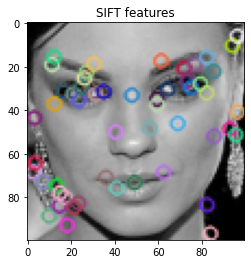

In [37]:
img = train_X_FACEREC[0,:]
gray = cv2.cvtColor(np.uint8(img),cv2.COLOR_BGR2GRAY)
print(gray.shape)
sift = cv2.SIFT_create()
kp, des = sift.detectAndCompute(gray, None)
img0 = cv2.drawKeypoints(gray, kp, np.float32(img))
plt.title('SIFT features')
plt.imshow(img0)

*NOTE:* We observe that SIFT finds a lot of redundant and outlier features. This can generally be improved by choosing different parameters of the SIFT algorithm  

Plot a few HOG images

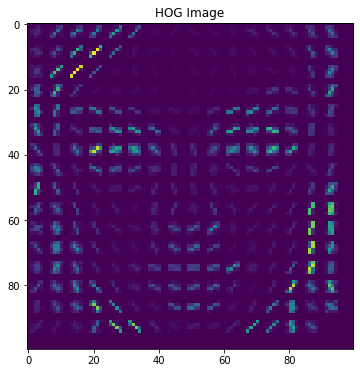

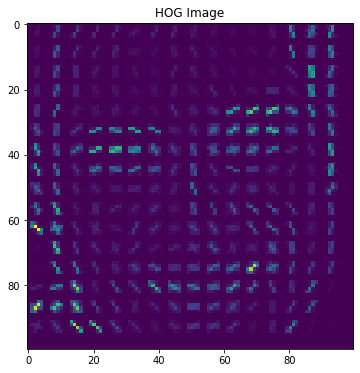

In [38]:
def plot_HogFigure(data):
    plt.figure(figsize=(6,6))
    _, hogImage = hog(data, orientations=10, pixels_per_cell=(6, 6),
        cells_per_block=(2, 2), transform_sqrt=True, block_norm="L1",
        visualize=True)

    hogImage = exposure.rescale_intensity(hogImage, out_range=(0, 255))
    hogImage = hogImage.astype("uint8")
    plt.imshow(hogImage)
    plt.title('HOG Image')
    plt.show()
    
# Plot random HOG images
plot_HogFigure(train_X_HAAR[0,:])
plot_HogFigure(train_X_HAAR[9,:])

[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.000s...
[t-SNE] Computed neighbors for 80 samples in 0.007s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 0.334362
[t-SNE] KL divergence after 250 iterations with early exaggeration: 45.800541
[t-SNE] KL divergence after 500 iterations: 0.042038


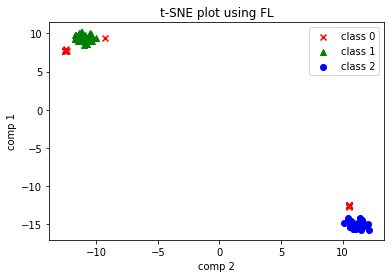

[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.000s...
[t-SNE] Computed neighbors for 80 samples in 0.002s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 0.530126
[t-SNE] KL divergence after 250 iterations with early exaggeration: 57.659504
[t-SNE] KL divergence after 500 iterations: 0.467251


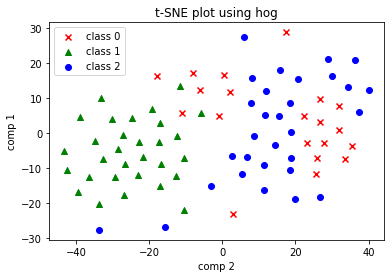

[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.000s...
[t-SNE] Computed neighbors for 80 samples in 0.004s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 0.539246
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.161911
[t-SNE] KL divergence after 500 iterations: 0.173050


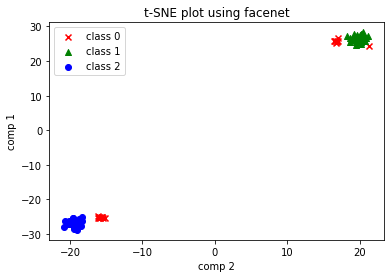

[t-SNE] Computing 79 nearest neighbors...
[t-SNE] Indexed 80 samples in 0.001s...
[t-SNE] Computed neighbors for 80 samples in 0.006s...
[t-SNE] Computed conditional probabilities for sample 80 / 80
[t-SNE] Mean sigma: 11.225513
[t-SNE] KL divergence after 250 iterations with early exaggeration: 61.047783
[t-SNE] KL divergence after 500 iterations: 0.688766


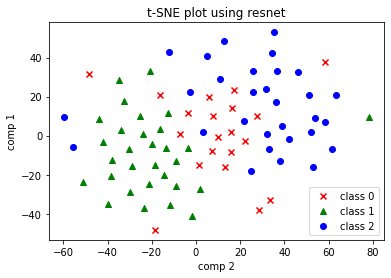

In [39]:
plot_TSNE(features=train_feats_FACEREC, ttl='FL', target_y=train_y_FACEREC)                      # using the facial landmarks features (default)
plot_TSNE(features=train_feats_HAAR, ttl='hog', target_y=train_y_HAAR)                           # using hog features, on original train dataset
embedder = FaceNet()
train_X_list = [train_X_FACEREC[i,:].astype(np.uint8) for i in range(train_X_FACEREC.shape[0])]  # needs a list of cropped images
ftrs_facenet = embedder.embeddings(train_X_list)

plot_TSNE(features=ftrs_facenet, ttl='facenet', target_y=train_y_FACEREC)                        # using FaceNet features on clean train dataset

resnet = ResnetExtractor()
ftrs_resnet = resnet(train_X_FACEREC)
plot_TSNE(features=ftrs_resnet, ttl='resnet', target_y=train_y_FACEREC)

## 1.4. PCA plots  
 
Below there is a PCA implementation using Singular Value Decomposition (SVD) and we plot reconstructed faces using different number of principal components. First, we need to convert our dataset (a 3D array with dimensions number_of_samples x Height x Width) to a new 2D matrix with dimensions Height x Width x number_of_samples in order to apply SVD. Next, it is important to center the data and subtract the "mean" image from every sample of our dataset. If we don't do this, the 1st principal component may pierce the cloud not along its main direction, and will be statistically misleading.



![](https://i.stack.imgur.com/9vENg.jpg)


Using SVD we factorize our 2D matrix into three matrices. The reason why we use SVD is that the entries in the diagonal matrix $Σ$ are all real and nonnegative. In the eigendecomposition, the entries of D can be any complex number - negative, positive, imaginary. Another reason is that SVD always exists for any sort of rectangular or square matrix, whereas the eigendecomposition can only exists for square matrices, and even among square matrices sometimes.

Number of Images:  80
Height x Width : 10000
2D Matrix shape: (10000, 80)
X: (10000, 80)
U: (10000, 80)
Sigma: (80,)
V^T: (80, 80)
Plot eigenfaces using SVD
Plot reconstructed faces using all eigenfaces
Plot reconstructed faces using only n_components eigenfaces


Text(0, 0.5, 'cumulative explained_variance_ratio')

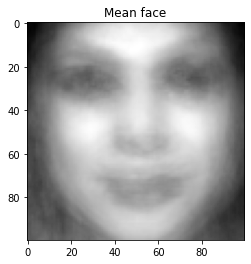

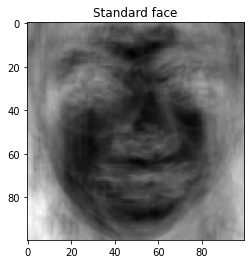

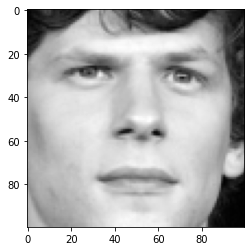

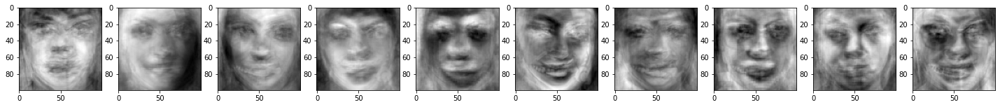

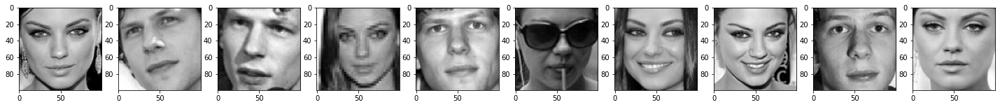

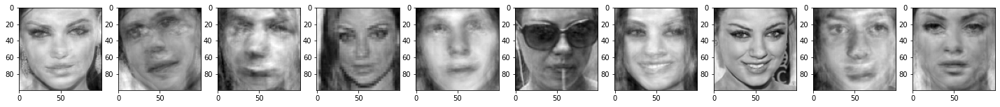

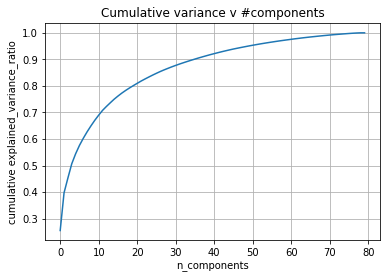

In [40]:
train_X_FACEREC.shape
gray_images_array = data2grayscale(train_X_FACEREC)
mean_face =np.mean(gray_images_array, axis=0) #compute mean face from the dataset
std_face = np.std(gray_images_array, axis = 0)
height = gray_images_array.shape[1]
width = gray_images_array.shape[2]
# Subtract mean face from every image
list_images = []
for ii in range(gray_images_array.shape[0]):
    mean_subtraction_image = (gray_images_array[ii, :, :] - mean_face) / std_face
    list_images.append(mean_subtraction_image)
mean_subtraction_array = np.array(list_images)
plt.figure()
plt.imshow(mean_face, cmap='gray')
plt.title('Mean face')
plt.figure()
plt.imshow(std_face, cmap='gray')
plt.title('Standard face')
plt.figure()
# Create m x d data matrix
m = mean_subtraction_array.shape[0] # Number of images
d = height * width # (Height X Width)
X = np.reshape(mean_subtraction_array, (m, d)).T # Reshape to 2D matrix

print('Number of Images: ', m)
print('Height x Width :', d)
print('2D Matrix shape:', X.shape)

# Plot one image for debugging purposes
plt.imshow(mean_face + std_face * np.reshape(X[:,int((X.shape[1])/2)], (height, width)), cmap='gray')

U, Sigma, VT = np.linalg.svd(X, full_matrices=False) # Apply SVD

# Sanity check on dimensions
print("X:", X.shape)
print("U:", U.shape)
print("Sigma:", Sigma.shape)
print("V^T:", VT.shape)

n = 10 # Number of eigen faces to plot

print("Plot eigenfaces using SVD")
# Plot eigenfaces
fig, axs = plt.subplots(1, n, figsize=(25,10))

for ii in range(n):
    axs[ii].imshow(np.reshape (U[:, ii], (height, width)), cmap='gray') # Plot eigenfaces
print("Plot reconstructed faces using all eigenfaces")
# Plot n reconstructed faces using all eigenfaces    
fig, axs = plt.subplots(1, n, figsize=(25,10))

for ii in range(n):
    recon_img = U @ U.T @ X[:, ii]
    axs[ii].imshow(std_face * np.reshape (recon_img, (height, width)) + mean_face, cmap='gray')
print("Plot reconstructed faces using only n_components eigenfaces")
# Plot n reconstructed faces using only n_components
n_components = 30
fig, axs = plt.subplots(1, n, figsize=(25,10))

for ii in range(n):
    recon_img = U[:,:n_components] @ U[:,:n_components].T @ X[:, ii]
    axs[ii].imshow(std_face * np.reshape(recon_img, (height, width)) + mean_face, cmap='gray')

plt.figure()
lam = Sigma**2
Pov=np.cumsum(lam)/np.sum(lam)
plt.plot(Pov)
plt.grid()
plt.title('Cumulative variance v #components')
plt.xlabel('n_components')
plt.ylabel('cumulative explained_variance_ratio')

A vital part of using PCA in practice is the ability to estimate how many components are needed to describe the data. This can be determined by looking at the cumulative explained variance ratio as a function of the number of components. The curve below indicates the information (as measured by the variance) that's contained within the first $N$ components. We observe that the first 10 components contain only 70% of the variance, while the first 64 components seem to be adequate in order to get close to 99% of the variance.

It is apparent that a two-dimensional projection loses a lot of information and that we'd need at least 25 components to retain 90% of the variance. This plot is indicative of the level of redundancy present in high-dimensional feature spaces

## Mean and standard faces
One interesting part of PCA is that we can compute the “mean” and the "standard deviation" faces, which can be interesting to examine. Below, we extract PCA features from the data, and calculate the mean and std faces.

(<AxesSubplot:title={'center':'SD face'}>,
 (-0.5, 99.5, 99.5, -0.5),
 Text(0.5, 1.0, 'SD face'))

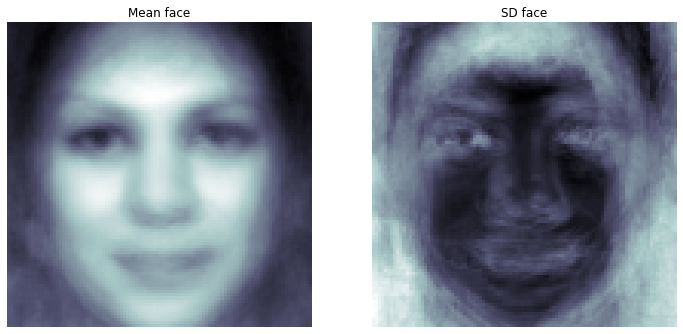

In [41]:
# PCA 
n_comp = 64 # 64 Principal components
pipeline = Pipeline([('scaling', StandardScaler()), ('pca', PCA(n_components=n_comp))])
faces_proj = pipeline.fit_transform(convert_imgs_for_PCA(train_X_HAAR))

# Mean and SD imgs
mean_face = np.reshape(pipeline.named_steps['scaling'].mean_, (100,100))
sd_face = np.reshape(np.sqrt(pipeline.named_steps['scaling'].var_), (100,100))
plt.figure(figsize=(12,8))
plt.subplot(121), plt.imshow(mean_face, cmap=plt.cm.bone), plt.axis('off'), plt.title('Mean face')
plt.subplot(122), plt.imshow(sd_face, cmap=plt.cm.bone), plt.axis('off'), plt.title('SD face')

(None,
 Text(0.5, 1.0, 'Cumulative variance v #components'),
 (-3.1500000000000004, 66.15, 0.20770229152327843, 1.0194952346998922),
 Text(0.5, 0, 'n_components'),
 Text(0, 0.5, 'cumulative explained_variance_ratio_'))

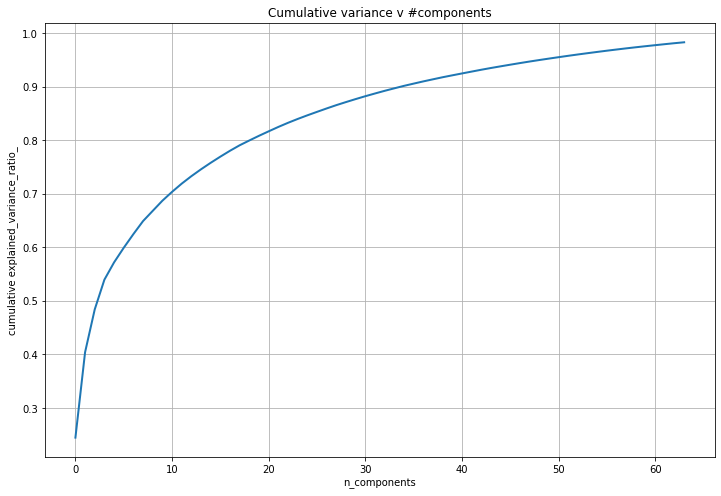

In [42]:
plt.figure(figsize=(12, 8))
plt.plot(np.cumsum(pipeline.named_steps['pca'].explained_variance_ratio_), linewidth=2)
plt.grid(),plt.title('Cumulative variance v #components'), plt.axis('tight'), plt.xlabel('n_components'), plt.ylabel('cumulative explained_variance_ratio_')


### 1.4.1. Reconstruct Images
The figure below shows the reconstruction of the images from just 64 of the ~10,000 initial features. This visualization makes it clear why the PCA feature selection used in In-Depth: Support Vector Machines was so successful: although it reduces the dimensionality of the data by nearly a factor of 20, the projected images contain enough information that we might, by eye, recognize the individuals in the image. What this means is that our classification algorithm needs to be trained on 150-dimensional data rather than 3,000-dimensional data, which depending on the particular algorithm we choose, can lead to a much more efficient classification.

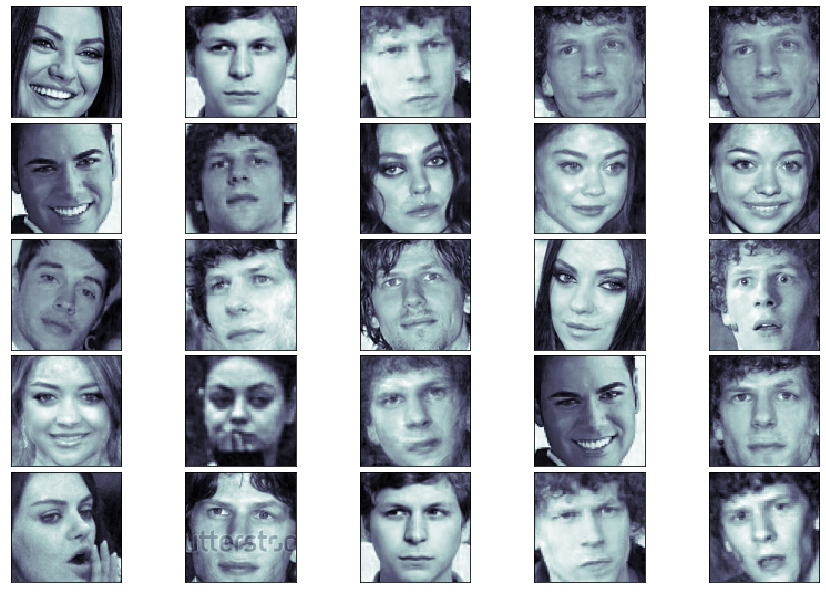

In [43]:
# face reconstruction
faces_inv_proj = pipeline.named_steps['pca'].inverse_transform(faces_proj) 
fig = plt.figure(figsize=(12,8)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 

j = 1
np.random.seed(0)
for i in np.random.choice(range(train_X_HAAR.shape[0]), 25): 
    ax = fig.add_subplot(5, 5, j, xticks=[], yticks=[]) 
    ax.imshow(mean_face + sd_face*np.reshape(faces_inv_proj,(80,100,100)) [i,:], cmap=plt.cm.bone, interpolation='nearest')
    j += 1

### 1.4.2. Eigenface Plots
In this section we plot the first N eigenfaces using the built-in PCA method by scikit-learn.

In this case, it can be interesting to visualize the images associated with the first several principal components (these components are technically known as "eigenvectors," so these types of images are often called "eigenfaces"). As you can see in the figures, they are as creepy as they sound:

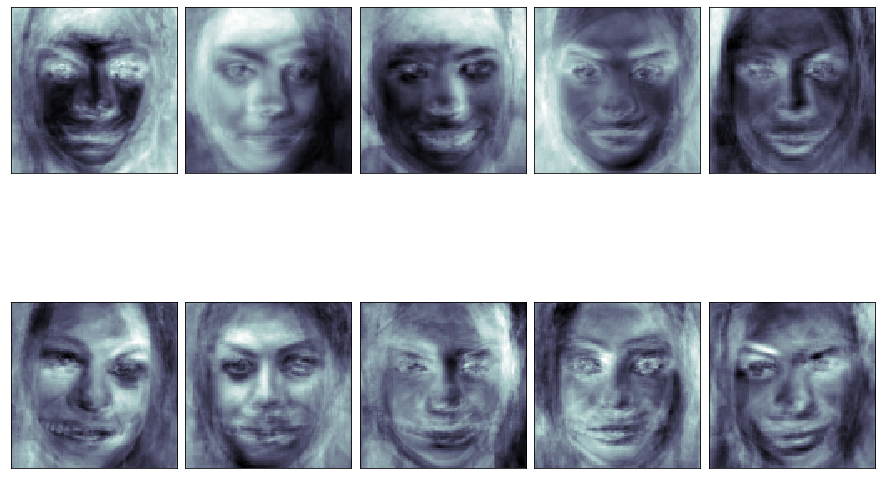

In [44]:
fig = plt.figure(figsize=(12,8)) 
fig.subplots_adjust(left=0, right=1, bottom=0, top=1, hspace=0.05, wspace=0.05) 
# plot the first 10 eigenfaces
for i in range(10): 
    ax = fig.add_subplot(2, 5, i+1, xticks=[], yticks=[])
    ax.imshow(np.reshape(pipeline.named_steps['pca'].components_[i,:], (100,100)), cmap=plt.cm.bone, interpolation='nearest')

### 1.4.3. Feature Space Plots
The next figure shows the images projected on and reconstructed from the first two eigenfaces. The similar images stay in close proximity whereas the dissimilar ones (w.r.t. projection on the first 2 dominant eigenvectors) are far apart in the 2D space.

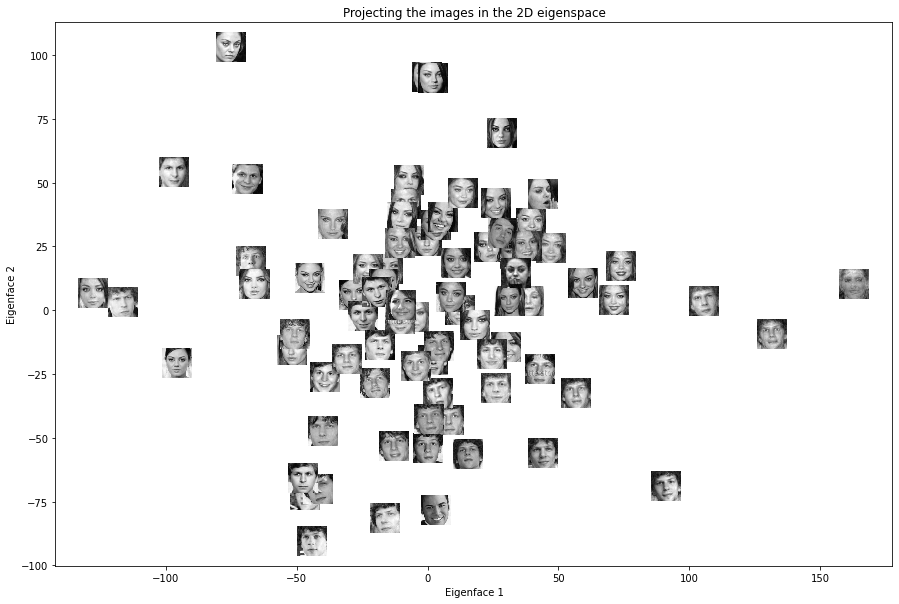

In [45]:
pca_extractor = PCAFeatureExtractor(n_components=64)
pca_faces_proj = pca_extractor.transform(train_X_HAAR)
faces_inv_proj_2 = np.reshape(pca_extractor.inverse_transform(pca_faces_proj),(80,100,100))

fig,ax = plt.subplots()

ax.scatter(pca_faces_proj[:,0], pca_faces_proj[:,1])
for x0, y0, rec_face in zip(pca_faces_proj[:,0], pca_faces_proj[:,1], faces_inv_proj_2):
    ab = AnnotationBbox(OffsetImage(mean_face + sd_face * rec_face, zoom=0.3, cmap='gray'), (x0, y0), frameon=False)
    ax.add_artist(ab)
ax.set_title('Projecting the images in the 2D eigenspace')
ax.set_xlabel('Eigenface 1')
ax.set_ylabel('Eigenface 2')
fig.set_figheight(10)
fig.set_figwidth(15)

For more efficient computations we use matrix multiplication instead of i.e. using 'for' loops to do it manually. Generally, if the number of samples $n$ is less than or equal to the number of features, the n-th PC will be constant zero (eigenvalue = 0). Since we never do PCA using  more than 80 number of components, the returned eigenvalues are never 0. From the 2 different implementations of PCA we observe that both give similar results.

## 1.5. Discussion
The HOG and SIFT feature descriptors belong to the handcrafted feature descriptor category and are pretty generic. SIFT has the extra advantage of being invariant to scale and rotation, so the extracted features tend to be more robust than HOG. Even though they are still used in some cases, they were developed more than a decade ago and they are a bit outdated. PCA features are derived by learning patterns from the data itself. Facial Landmarks tend to give more discriminative features, since they are related to the structure of the face. Modern deep learning methods e.g. FaceNet, tend to extract better quality features because of their more complex architecture and training process. Deep learning, however, is generally data hungry and extracted features tend to be [too specific to the training dataset](https://arxiv.org/pdf/1910.13796.pdf). This means that if it's not well constructed, there's a danger of poor performance in an unknown dataset. On the contrary, handcrafted features are more general and sometimes they are adequate for the task at hand.

# 2. Evaluation Metrics
## Generic class for training models
The following class can be used for training different models and contains various metrics such as accuracy, precision and recall.
As example metric we take the accuracy since it is the one used for evaluating our performance on kaggle. Informally, accuracy is the proportion of correct predictions over the total amount of predictions.

In [46]:
class Trainer:
    '''Class that trains a model with a provided dataset'''
    
    def __init__(self, model, preprocessor=None):
        self.model = model
        self.preprocessor = preprocessor
        self.metrics = {
            'accuracy': None,
            'precision': None,
            'recall': None,
            'f1_score': None
        }
        self.training_duration = 0
    
    def train(self, features, train_y):
        if self.preprocessor is not None:
            try:
                features = self.preprocessor(features)
            except ValueError:
                features = np.asarray([self.preprocessor(x) for x in features])

        self.model.fit(features, train_y)  # train model on training set
        pred_y = self.model(features)  # predict labels of training set
        
        # calculate metrics
        self.metrics['accuracy'] = accuracy_score(train_y, pred_y)
        self.metrics['precision'] = precision_score(train_y, pred_y, average='micro')
        self.metrics['recall'] = recall_score(train_y, pred_y, average='micro')
        self.metrics['f1_score'] = f1_score(train_y, pred_y, average='micro')
    
    @property
    def accuracy(self):
        return self.metrics['accuracy']
    
    @property
    def recall(self):
        return self.metrics['recall']
    
    @property
    def precision(self):
        return self.metrics['precision']
    
    @property
    def f1_score(self):
        return self.metrics['f1_score']
    
    @property
    def all_metrics(self):
        return self.metrics

# 3. Classifiers
## 3.1 Classifier \#1: Multiclass SVM
In this section we create a Multi-class [SVM classifier](https://en.wikipedia.org/wiki/Support-vector_machine) based on the corresponding implementation of the [scikit-image](https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html) library. Support Vector Machines (SVM) are models used in machine learning for supervized classification or regression. An SVM aims to map points in N-dimensional space in order to achieve maximum separation between points from different classes.

MultiClassSVM has two main functions, fit and predict. Fit performs a grid-based hyperparameter search to find a good set of parameters for training an SVM classifier on the data and then trains the SVM using those parameters. The kernel (Linear or RBF), the regularization parameter C, and the kernel coefficient gamma are the parameters that are tuned. Finally, predict estimates the class/label of input data samples.

Evaluation for all classifiers is done using the accuracy metric with [Leave-one-out Cross Validation](https://en.wikipedia.org/wiki/Cross-validation_(statistics)#Leave-one-out_cross-validation) in order to evaluate the generalization ability of the classifiers.

In [47]:
class MultiClassSVM:
    """An SVM classifier for face recognition"""

    def __init__(self):
        self.stdslr = None
        self.clf = None

    def fit(self, features, train_y):
        self.stdslr = StandardScaler().fit(features)    # create standardization scalar

        # initialize grid search params
        kernels = ['linear', 'rbf']
        C_range = np.logspace(-2, 10, 13)               # logarithmic grid for c parameter
        gamma_range = np.logspace(-9, 3, 13)            # log grid for gamma param
        param_grid = dict(kernel=kernels, gamma=gamma_range, C=C_range)  # create a dict with these params
        cv = LeaveOneOut()                              # Use leave-one-out cross validation
        cv.get_n_splits(features)
        grid = GridSearchCV(                            # create hyperparameter search grid
            SVC(kernel='linear', decision_function_shape='ovr', break_ties=False),
            param_grid=param_grid, cv=cv)
        grid.fit(features, train_y)                     # fit grid to training datas
        print(f"The best parameters are {grid.best_params_} with a score of {grid.best_score_}")
        self.clf = make_pipeline(
            StandardScaler(),
            SVC(kernel='linear',
                C=grid.best_params_['C'],
                gamma=grid.best_params_['gamma'],
                decision_function_shape='ovr',
                break_ties=False))
        self.clf.fit(features, train_y)                 # fit the classifier to training features

    def predict(self, X):
        return self.clf.predict(X)

    def __call__(self, X):
        return self.predict(X)

## 3.2. Classifier #2: double SVM  
This time we use 2 binary classifiers, one to identify class 1 (Jesse) and one for class 2 (Mila) and then we merge their results. Theoretically, this set of classifiers will perform better in cases where the test dataset has many images of unknown faces that belong to class 0. It is safe to assume that many of the detected faces are going to be neither Jesse, nor Mila. For each classifier we consider the other 2 classes to be the negative (or 0) class, giving them more weight. This also helps to better distinguish class 1 from class 2, but in this particular example, it doesn't seem to matter since they appear to be quite different already. 

In [48]:
class BSVM:
    """Create 2 simple linear Binary SVM classifiers, one for class 1 and one for class 2"""
    def __init__(self):
        self.stdslr = None
        self.clf1 = None                                    # classifier detecting class 1 (Jesse)
        self.clf2 = None                                    # classifier detecting class 2 (Mila)

    def fit(self, features, train_y):
        """
        Returns
        -------
        self : BSVM
        """
        self.stdslr = StandardScaler().fit(features)        # create standardization scalar
        self.features = self.stdslr.transform(features)     # fit the scalar to training data
        C_range = np.logspace(-2, 10, 13)                   # logarithmic grid for c parameter
        gamma_range = np.logspace(-9, 3, 13)                # log grid for gamma param
        param_grid = dict(gamma=gamma_range, C=C_range)     # create a dict with these params
        cv = LeaveOneOut()
        cv.get_n_splits(features)
        grid = GridSearchCV(SVC(kernel='linear', decision_function_shape='ovr', break_ties=False), param_grid=param_grid, n_jobs=-1, cv=cv)
        
        # train first class svm
        features_temp = np.zeros_like(train_y)              # construct training labels
        features_temp[train_y==1] = 1
        grid.fit(self.features, features_temp)
        print(f"The best parameters are {grid.best_params_} with a score of {grid.best_score_}")
        self.clf1 = make_pipeline(
            StandardScaler(),
            SVC(kernel='linear', C=grid.best_params_['C'], gamma=grid.best_params_['gamma'], decision_function_shape='ovr', break_ties=False, probability=True))
        self.clf1.fit(features, np.array(features_temp))     # fit the classifier to training features
        
        # train second class svm
        features_temp = np.zeros_like(train_y)
        features_temp[train_y==2] = 1
        grid.fit(self.features, features_temp)
        print(f"The best parameters are {grid.best_params_} with a score of {grid.best_score_}")
        self.clf2 = make_pipeline(
            StandardScaler(),
            SVC(kernel='linear', C=grid.best_params_['C'], gamma=grid.best_params_['gamma'], decision_function_shape='ovr', break_ties=False, probability=True))
        self.clf2.fit(features, np.array(features_temp)) 
        
    def predict(self, features):
        res1 = self.clf1.predict(features)
        res2 = self.clf2.predict(features)
        tmp = res1+2*res2                                   # construct predicted labels
        prob1 = self.clf1.predict_proba(features)
        prob2 = self.clf2.predict_proba(features)
        for i,cls in enumerate(tmp):                        # implementation using probabilities
            if cls==3:
                if (prob1[i][1]>prob2[i][1]):
                    tmp[i]=1
                elif(prob1[i][1]<=prob2[i][1]):
                    tmp[i]=2
        return tmp
        
    def __call__(self, X):
        return self.predict(X)
    
    

## 3.3. Classifier #3: MLP  
The third implemented classifier is an [Artificial Neural Network (ANN)](https://en.wikipedia.org/wiki/Artificial_neural_network) and specifically a [Multilayer Perceptron (MLP)](https://en.wikipedia.org/wiki/Multilayer_perceptron). An MLP consists of at least three layers, the input layer, one or more hidden layers and an output layer. An MLP can fit a non-linear function by training on labeled data with backpropagation.

The following implmentation does a grid-based hyperparamter search to tune the number and size of hidden layers, the non-linear activation function, the optimization algorithm for the backprogation, the L2 regularization parameter $\alpha$ and the learning rate, with regard to whether to use a fixed or an adaptive learning rate. Finally, before training or inference the network requires that the input data are standardized for best performance.

In [49]:
from sklearn.neural_network import MLPClassifier
class MLP:
    """Create a simple multiclass Multi-layer perceptron"""
    def __init__(self):
        self.stdslr = None
        self.clf = None                                    # classifier init

    def fit(self, features, train_y):
        """
        Returns
        -------
        self : MLP
        """
        self.stdslr = StandardScaler().fit(features)        # create standardization scalar
        self.features = self.stdslr.transform(features)     # fit the scalar to training data
        param_grid = {
            'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
            'activation': ['tanh', 'relu'],
            'solver': ['sgd', 'adam'],
            'alpha': [0.0001, 0.05],
            'learning_rate': ['constant','adaptive'],
        }
        mlp = MLPClassifier(max_iter=1000)
        self.clf = GridSearchCV(mlp, param_grid=param_grid, n_jobs=-1, cv= LeaveOneOut())
        
        # train MLP
        self.clf.fit(self.features, train_y)
        print(f"The best parameters are {self.clf.best_params_} with a score of {self.clf.best_score_}")
        
    def predict(self, features):
        return self.clf.predict(self.stdslr.transform(features))
        
    def __call__(self, X):
        return self.predict(X)

## 3.4. Classifier #4: Random forest  
[Random forests](https://en.wikipedia.org/wiki/Random_forest#:~:text=Random%20forests%20or%20random%20decision,average%20prediction%20(regression)%20of%20the) is a supervised learning algorithm that can be used both for classification and regression. They are an ensemble learning method that operate by constructing a multitude of decision trees and outputting the class that is the mode of the classes. In a way they are similar to MLP since both of these methods can be considered as a black box.

In [50]:
from sklearn.ensemble import RandomForestClassifier
class RandForest:
    """Create a simple multiclass Random Forest"""
    def __init__(self):
        self.stdslr = None
        self.clf = None                                    # classifier init

    def fit(self, features, train_y):
        """
        Returns
        -------
        self : RandomForest
        """
        self.stdslr = StandardScaler().fit(features)        # create standardization scalar
        self.features = self.stdslr.transform(features)     # fit the scalar to training data
        param_grid = {
            'n_estimators': [50, 100, 150, 200]
        }
        rf = RandomForestClassifier(random_state = 2)
        self.clf = GridSearchCV(rf, param_grid=param_grid, n_jobs=-1, cv=LeaveOneOut())
        
        # train RF
        self.clf.fit(self.features, train_y)
        print(f"The best parameters are {self.clf.best_params_} with a score of {self.clf.best_score_}")
        
    def predict(self, features):
        return self.clf.predict(self.stdslr.transform(features))
        
    def __call__(self, X):
        return self.predict(X)


# 4. Experiments

Here we present some indicative pipelines of some of the the experiments we tried using the implemented feature extractors and classification models

## 4.1. Multi-class SVM with PCA features
Train an SVM classifier on PCA features and HAAR preprocessor and evaluate its performance on the training dataset.

In [51]:
clf = MultiClassSVM()
feature_extractor = PCAFeatureExtractor(64)
trainer = Trainer(clf, feature_extractor)
trainer.train(train_X_HAAR, train_y_HAAR)
print(f'Metrics: {trainer.metrics}')

The best parameters are {'C': 10.0, 'gamma': 1e-05, 'kernel': 'rbf'} with a score of 0.85
Metrics: {'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1_score': 1.0}


## 4.2. MLP with HOG features
Trains an MLP classifier on HOG features and FACEREC preprocessor and evaluate its performance on the training dataset.

In [52]:
clf = MLP()
feature_extractor = HOGFeatureExtractor(visualize=True)
trainer = Trainer(clf, None)
trainer.train(train_feats_FACEREC, train_y_FACEREC)
print(f'Metrics: {trainer.metrics}')

The best parameters are {'activation': 'tanh', 'alpha': 0.0001, 'hidden_layer_sizes': (50, 50, 50), 'learning_rate': 'adaptive', 'solver': 'adam'} with a score of 1.0
Metrics: {'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1_score': 1.0}


## 4.3. Random Forest with FaceNet 512-dimensional features  
Trains a RF classifier on FaceNet features and FACEREC preprocessor and evaluate its performance on the training dataset.

In [53]:
"""Calculate features of clean training dataset"""
clf = RandForest()
train_X = train_X_FACEREC

feature_extractor = FaceNetExtractor()
trainer = Trainer(clf, None)
trainer.train(feature_extractor(train_X), train_y_FACEREC)
print(f'Metrics: {trainer.metrics}')

The best parameters are {'n_estimators': 50} with a score of 1.0
Metrics: {'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1_score': 1.0}


## 4.4. Double BSVM with ResNet 2048-dimensional features  
Trains BSVM classifier on Resnet features and FACEREC preprocessor and evaluate its performance on the training dataset.

In [54]:
clf = BSVM()
train_X = train_X_FACEREC

feature_extractor = ResnetExtractor()
trainer = Trainer(clf, None)
trainer.train(feature_extractor(train_X), train_y_FACEREC)
print(f'Metrics: {trainer.metrics}')

The best parameters are {'C': 0.01, 'gamma': 1e-09} with a score of 0.9625
The best parameters are {'C': 0.01, 'gamma': 1e-09} with a score of 0.875
Metrics: {'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1_score': 1.0}


## 4.5. Double BSVM with facial landmarks 128-dimensional features  
Trains an BSVM classifier on FL features and FACEREC preprocessor and evaluate its performance on the training dataset.

In [55]:
"""Calculate features of clean training dataset"""
clf = BSVM()
feature_extractor = FaceLandmarksExtractor()
trainer = Trainer(clf, None)
trainer.train(train_feats_FACEREC, train_y_FACEREC)
print(f'Metrics: {trainer.metrics}')

The best parameters are {'C': 0.01, 'gamma': 1e-09} with a score of 1.0
The best parameters are {'C': 0.01, 'gamma': 1e-09} with a score of 1.0
Metrics: {'accuracy': 1.0, 'precision': 1.0, 'recall': 1.0, 'f1_score': 1.0}


# 5. Publishing best results
We take the last of the previous classifiers and we make predictions on the test set

In [56]:
test_X = test_X_FACEREC
test_samples = test_samples_FACEREC 
ider = ider_test_FACEREC
feature_extractor = FaceLandmarksExtractor()

test_y_hat = clf(test_feats_FACEREC)                                                            # predict face level labels for test dataset
test_y_star = np.array([np.max(test_y_hat[ider==i]) for i in range(np.unique(ider).shape[0])])  # construct final predicted image level labels 

### Save the .CSV file

In [57]:
res_path = '/kaggle/results/'
if not os.path.exists(res_path):
    os.mkdir(res_path)
    
filename = clf.__class__.__name__+'_'+feature_extractor.__class__.__name__[:-9]+'_'+'submission.csv'
submission = test.copy().drop('img', axis = 1)
submission['class'] = test_y_star
submission.to_csv(filename)

print(f'Submission saved to file {filename}')

Submission saved to file BSVM_FaceLandmarks_submission.csv


# 6. Discussion
In this assignment we had the opportunity to experiment with the face recognition task, using various data preprocessing and feature extraction techniques. Through visual inspection of the train image data we observed that there were quite a few issues with the dataset that needed to be addressed before training classifiers. For example, there were redundant/unwanted images that had to be removed, wrong annotations of data due to sub-optimal face detection etc. Improving face detection and cleaning the dataset proved instrumental in improving our accuracy scores.

Regarding feature extraction we looked into six different methods, namely HOG, PCA, Raw Facial Landmarks (FL), SIFT, FaceNet(FN) and ResNet50 features. Using t-SNE for dimensionality reduction for visualization of the features in 2D meant we could visually observe the separability of each feature detector on the training set, where Facial Landmarks and FaceNet features performed best with more distinct clusters per class. Four classifiers were implemented, namely, Multi-class SVM, Double binary SVM (BSVM), Multi-layer Perceptrons (MLP) and Random Forests (RF). 

We used the above mentioned features and classifiers in various combinations and we submitted some of the most promising results to the competition, achieving our highest score of 96.145% with the BSVM-FL combination. Trying to improve our final score, we also changed the way our final predicted target vector was constructed at an image level upon cases where the classifier predicted both classes 1 and 2 for faces in the same image (i.e. favor class 1, favor class 2 or pick at random). Some ideas we considered for improvement were using transfer learning to fit a pretrained deep learning model on our dataset and doing an exhaustive search to find the best Classifier and Feature Extractor pair.
